In [43]:
import sys
sys.path.insert(0, '../flygenvectors/')

import os
import numpy as np
from glob import glob
import pickle
import copy
from importlib import reload

import scipy.io as sio
from scipy import sparse, signal
from scipy.stats import zscore
from scipy.cluster import hierarchy

from sklearn.decomposition import PCA, FastICA
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph
from sklearn.linear_model import Ridge, LinearRegression
from sklearn.metrics import r2_score

import matplotlib.pyplot as plt
from matplotlib import axes, gridspec, colors
from mpl_toolkits import mplot3d
import matplotlib.pylab as pl
import matplotlib.cm as cm
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap

import data as dataUtils
import regression_model as reg_model
import plotting
# import flygenvectors.ssmutils as utils
import utils as futils
import clustering as flclust
import pdb

# from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('png', 'pdf')

import seaborn as sns
sns.set()
sns.set_style("white")
sns.set_context("talk")

## load data

In [44]:
# LOAD DATA ---------------------------------------------------------------------------
reload(reg_model)
# reload(futils)
reload(dataUtils)
remake_model = False

dirs = futils.get_dirs()

# datasets of just running
exp_list_full = [['2019_07_01','fly2'],
                ['2019_08_14','fly1'],
                ['2019_10_10','fly3'],
                ['2019_10_21','fly1'],
                ['2019_08_14','fly3_2'],
                ['2019_10_14','fly3'],
                ['2019_10_14','fly4'],
                ['2019_10_18','fly3'],
                ['2019_06_30','fly1'],
                ['2019_06_28','fly2'],
                ['2019_08_14','fly2'],
                ['2019_08_07','fly2'],
                ['2019_06_26','fly2'],
                ['2018_08_24','fly3_run1'],
                ['2018_08_24','fly2_run2']] #['2019_08_19','fly1_1'],

# datasets of running and flailing
exp_list_split = [
            ['2019_04_18','fly2'],
            ['2019_04_22','fly1'],
            ['2019_04_24','fly1'],
            ['2019_05_07','fly1']]

exp_list = exp_list_full.copy()
# exp_list.extend(exp_list_split)

In [45]:
data_tot = []
n_components = 100
for i in range(np.shape(exp_list)[0]):
    exp_date = exp_list[i][0]
    fly_num = exp_list[i][1]
    expt_id = exp_date+'_'+fly_num
    fig_dirs = futils.get_fig_dirs(expt_id)
    #data_dict = dataUtils.load_timeseries_simple(exp_date,fly_num,dirs['data'])
    data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
    data_tot.append({})
    data_tot[i]['data_dict'] = data_dict
   

## load regression model

In [46]:
# compile models
activity='dFF'
# prune='_prune' #'_noGamma' # set to '' to use full
model_fit_tot = []
model_fit_shifted_tot = []
for nf in range(len(data_tot)):
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    fig_dirs = futils.get_fig_dirs(expt_id)
    model_fit_tot.append( pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+activity+'_ols_reg_model_whole_3p2_all.pkl', "rb" ) ) )
    #model_fit_shifted_tot.append( pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+activity+'_ols_reg_model_shifted_whole_1p0'+prune+'.pkl', "rb" ) ))


### get full and null residuals

In [47]:
reload(reg_model)
# loop over datasets to compile summary dict
summary_dict_tot = []
use_beh_labels = True
# pdb.set_trace()

for nf in range(len(data_tot)):
    # for nf in [0]:
    print(nf,end=' ')
    split_behav = False
    if nf<len(data_tot)-3:
        use_beh_labels=True
    else:
        use_beh_labels=False

    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    data_dict = data_tot[nf]['data_dict']
    model_fit = copy.deepcopy(model_fit_tot[nf])
    model_fit_shifted = [] #copy.deepcopy(model_fit_shifted_tot[nf]) #not needed
    summary_dict_tmp = reg_model.get_summary_dict(expt_id, split_behav, data_dict, model_fit, 
                                                  model_fit_shifted, use_beh_labels)
    summary_dict_tot.append( summary_dict_tmp )
    
    # make residual the default ('dFF'='dFF_resid_base', 'dFF_full_base' is normal dFF)
    summary_dict_tot[-1]['data_dict']['dFF_full_base'] = copy.deepcopy(summary_dict_tot[-1]['data_dict']['dFF'])
    summary_dict_tot[-1]['data_dict']['dFF'] = summary_dict_tot[-1]['data_dict']['dFF_resid_base']
    

0 Number of cores: 16
1 Number of cores: 16
2 Number of cores: 16
3 Number of cores: 16
4 Number of cores: 16
5 Number of cores: 16
6 Number of cores: 16
7 Number of cores: 16
8 Number of cores: 16
9 Number of cores: 16
10 Number of cores: 16
11 Number of cores: 16
12 Number of cores: 16
13 Number of cores: 16
14 Number of cores: 16


## get clusters

#### null resid

In [6]:
reload(flclust)
if remake_model:
    for nf in range(len(exp_list)):
        print('\nFly '+str(nf)+' of '+str(len(exp_list)))
        
        # load processed data
        expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
        #data_dict_raw = dataUtils.load_timeseries_simple(exp_list[nf][0], exp_list[nf][1], dirs['data'])
        fig_dirs = futils.get_fig_dirs(expt_id)
        #data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
        data_dict = copy.deepcopy(summary_dict_tot[nf]['data_dict'])
        data_dict['dFF'] = data_dict['dFF_full_base']
        
        ### hierarchical clustering on training data
        remake_clusters = True
        clusto = flclust.flyg_clust_obj(data_dict)
        clusto.get_clusters()            # hierarchical clustering
        
        clusto.data_dict['dFF_resid_renorm'], mu, sig = clusto.normalize_rows_euc(data_dict['dFF'])                                
        clusto.get_simple_clusters(activity='dFF_resid_renorm') # corr-based clustering
        
        #print('step below seems slow. needed? fix?')
        clusto.get_simple_clusters_euc() # euclidian-distance-based clustering
        
        ### estimate distribution of variances for random clusters of size M
        #pdb.set_trace()
        clusto.null_dist, clusto.null_symmetry, clusto.null_dist_score = clusto.get_null_dist(n_samples=1000, mx_null=5)
        
        ## UPDATE THIS: SAMPLE NULL FROM CELLS WITH SIMILAR BEHAV. BROKEN W/ LATEST UPDATE
        #clusto.null_dist_beh, clusto.null_symmetry_beh, clusto.null_dist_score_beh = clusto.get_null_dist(n_samples=10, mx_null=4, behav_null=True)

        ### compare clusters to null distribution
        clusto.cross_validate_clusters()
        
        ### compute symmetry & distance measure for all clusters
        clusto.get_clust_symmetry()
        clusto.get_clust_dist_score()
        
        # sort clusters by number of members
        clusto.sort_clusters_by_n_members()

        # make color code for selected clusters
        clusto.make_clust_colors()
        
        # save model
        pickle.dump( clusto, open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model.pkl', "wb" ) )


Fly 0 of 15
N clusters: 1065
N clusters (simple): 24
N clusters (simple euc): 196
Max Clust size is 10
Computing null up to size = 5
2 3 4 
Fly 1 of 15
N clusters: 1133
N clusters (simple): 36
N clusters (simple euc): 158
Max Clust size is 11
Computing null up to size = 5
2 3 4 
Fly 2 of 15
N clusters: 1288
N clusters (simple): 47
N clusters (simple euc): 141
Max Clust size is 16
Computing null up to size = 5
2 3 4 
Fly 3 of 15
N clusters: 942
N clusters (simple): 37
N clusters (simple euc): 110
Max Clust size is 10
Computing null up to size = 5
2 3 4 
Fly 4 of 15
N clusters: 847
N clusters (simple): 34
N clusters (simple euc): 77
Max Clust size is 17
Computing null up to size = 5
2 3 4 
Fly 5 of 15
N clusters: 1289
N clusters (simple): 35
N clusters (simple euc): 173
Max Clust size is 10
Computing null up to size = 5
2 3 4 
Fly 6 of 15
N clusters: 879
N clusters (simple): 37
N clusters (simple euc): 121
Max Clust size is 8
Computing null up to size = 5
2 3 4 
Fly 7 of 15
N clusters: 

#### behav resid

In [48]:
reload(flclust)
if remake_model:
    for nf in range(len(exp_list)):
        print('\nFly '+str(nf)+' of '+str(len(exp_list)))
        
        # load processed data
        expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
        #data_dict_raw = dataUtils.load_timeseries_simple(exp_list[nf][0], exp_list[nf][1], dirs['data'])
        fig_dirs = futils.get_fig_dirs(expt_id)
        
        data_dict = summary_dict_tot[nf]['data_dict']
        #data_dict['dFF'] = data_dict['dFF_resid_base']
        
        ### hierarchical clustering on training data
        remake_clusters = True
        clusto = flclust.flyg_clust_obj(data_dict)
        clusto.get_clusters()            # hierarchical clustering
        
        clusto.data_dict['dFF_resid_renorm'], mu, sig = clusto.normalize_rows_euc(data_dict['dFF'])                                
        clusto.get_simple_clusters(activity='dFF_resid_renorm') # corr-based clustering
        
        #print('step below seems slow. needed? fix?')
        clusto.get_simple_clusters_euc() # euclidian-distance-based clustering
        
        ### estimate distribution of variances for random clusters of size M
        #pdb.set_trace()
        clusto.null_dist, clusto.null_symmetry, clusto.null_dist_score = clusto.get_null_dist(n_samples=1000, mx_null=5)
        
        ## UPDATE THIS: SAMPLE NULL FROM CELLS WITH SIMILAR BEHAV. BROKEN W/ LATEST UPDATE
        #clusto.null_dist_beh, clusto.null_symmetry_beh, clusto.null_dist_score_beh = clusto.get_null_dist(n_samples=10, mx_null=5, behav_null=True)

        ### compare clusters to null distribution
        clusto.cross_validate_clusters()
        
        ### compute symmetry & distance measure for all clusters
        clusto.get_clust_symmetry()
        clusto.get_clust_dist_score()
        
        # sort clusters by number of members
        clusto.sort_clusters_by_n_members()

        # make color code for selected clusters
        clusto.make_clust_colors()
        
        # save model
        pickle.dump( clusto, open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model_beh.pkl', "wb" ) )

In [81]:
# test clusters of fixed size
reload(flclust)
total_counts = [None]*len(exp_list)
# NC = 200
#if remake_model:
for nf in range(len(exp_list)):
    #nf=0
    NC = np.round(dim_summary[nf]['M_hat']).astype(int)
    print('Fly '+str(nf)+' of '+str(len(exp_list)))

    # load processed data
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    #data_dict_raw = dataUtils.load_timeseries_simple(exp_list[nf][0], exp_list[nf][1], dirs['data'])
    fig_dirs = futils.get_fig_dirs(expt_id)

    data_dict = summary_dict_tot[nf]['data_dict']
    #data_dict['dFF'] = data_dict['dFF_resid_base']

    ### hierarchical clustering on training data
    remake_clusters = True
    clusto = flclust.flyg_clust_obj(data_dict)
    clusto.get_clusters(n_clusters=NC)            # hierarchical clustering

    ### compute symmetry & distance measure for all clusters
    # clusto.get_clust_dist_score()

    # sort clusters by number of members
    clusto.sort_clusters_by_n_members()

    l = np.unique(clusto.cluster.labels_)
    counts = np.zeros(len(l))
    for i in range(len(l)):
        counts[i] = (clusto.cluster.labels_==l[i]).sum()
    total_counts[nf] = counts

Fly 0 of 15
N clusters: 196
Fly 1 of 15
N clusters: 117
Fly 2 of 15
N clusters: 69
Fly 3 of 15
N clusters: 84
Fly 4 of 15
N clusters: 17
Fly 5 of 15
N clusters: 119
Fly 6 of 15
N clusters: 90
Fly 7 of 15
N clusters: 57
Fly 8 of 15
N clusters: 82
Fly 9 of 15
N clusters: 66
Fly 10 of 15
N clusters: 55
Fly 11 of 15
N clusters: 69
Fly 12 of 15
N clusters: 35
Fly 13 of 15
N clusters: 86
Fly 14 of 15
N clusters: 154


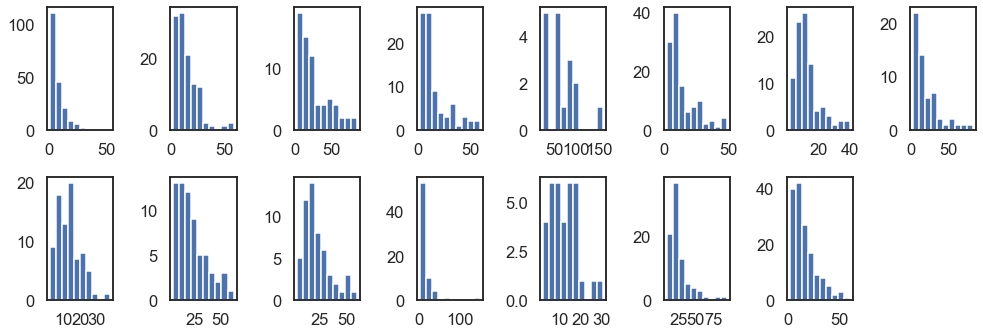

In [83]:
plt.figure(figsize=(14,5))
for nf in range(len(exp_list)):
    plt.subplot(2,8,nf+1)
    # plt.bar([i for i in range(2,7)], n_sig_clust_by_size[2:],color='gray',width=0.9)
    plt.hist(total_counts[nf])

# plt.ylabel('Count')
# plt.xlabel('Cluster Size')
# plt.xticks([2,4,6])
plt.tight_layout()
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_sig_clust_count.pdf',transparent=True, bbox_inches='tight')
plt.show()

### test elbow method

In [84]:
def get_val_var(self):
    self.clust_val_var = np.zeros(self.nClust)
    for k in range(self.nClust):
        cIds = [i for i,j in enumerate(self.cluster.labels_) if j==k]
        l = len(cIds)
        self.clust_val_var[k] = self.data_dict['val_all'][:,cIds].var(axis=1).mean()

5 10 15 20 25 30 35 40 45 50 55 60 65 70 75 80 85 90 95 100 105 110 115 120 125 130 135 140 145 150 155 160 165 170 175 180 185 190 195 200 205 210 215 220 225 230 235 240 245 250 255 260 265 270 275 280 285 290 295 

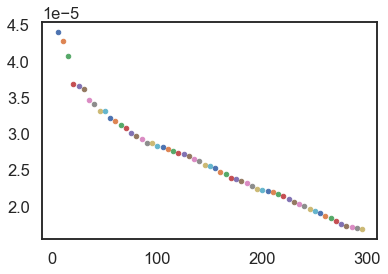

In [96]:
# test clusters of fixed size
reload(flclust)
total_counts = [None]*len(exp_list)
# NC = 200
#if remake_model:
# for nf in range(len(exp_list)):
nf=0
for NC in range(5,300,5):
    # NC = 300 #np.round(dim_summary[nf]['M_hat']).astype(int)
    #print('Fly '+str(nf)+' of '+str(len(exp_list)))

    # load processed data
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    #data_dict_raw = dataUtils.load_timeseries_simple(exp_list[nf][0], exp_list[nf][1], dirs['data'])
    fig_dirs = futils.get_fig_dirs(expt_id)

    data_dict = summary_dict_tot[nf]['data_dict']
    #data_dict['dFF'] = data_dict['dFF_resid_base']

    ### hierarchical clustering on training data
    remake_clusters = True
    clusto = flclust.flyg_clust_obj(data_dict)
    clusto.get_clusters(n_clusters=NC, quiet=True)            # hierarchical clustering
    print(NC, end=' ')
    ### compute symmetry & distance measure for all clusters
    # clusto.get_clust_dist_score()

    # sort clusters by number of members
    clusto.sort_clusters_by_n_members()
    get_val_var(clusto)

    plt.plot(NC, clusto.clust_val_var.mean(),'.')
plt.show()

In [94]:
clusto.clust_val_var[clusto.clust_val_var>0].mean()

1.5944720306352086e-05

# look at full tree

In [67]:
# from scipy.cluster.hierarchy import dendrogram

# def get_linkage(model):
#     # Create linkage matrix and then plot the dendrogram

#     # create the counts of samples under each node
#     counts = np.zeros(model.children_.shape[0])
#     n_samples = len(model.labels_)
#     for i, merge in enumerate(model.children_):
#         current_count = 0
#         for child_idx in merge:
#             if child_idx < n_samples:
#                 current_count += 1  # leaf node
#             else:
#                 current_count += counts[child_idx - n_samples]
#         counts[i] = current_count
#     linkage_matrix = np.column_stack([model.children_, model.distances_,
#                                       counts]).astype(float)
#     return linkage_matrix

### Via Euclidean Distance, as default

In [276]:
nf=7 #-1 #-2
# load processed data
expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
print(expt_id)
fig_dirs = futils.get_fig_dirs(expt_id)

# data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
data_dict = summary_dict_tot[nf]['data_dict']

### hierarchical clustering on training data
clusto = flclust.flyg_clust_obj(data_dict)
clusto.get_clusters()            # hierarchical clustering

linkage_matrix = clusto.get_linkage() 

2019_10_18_fly3
N clusters: 813


In [277]:
# plotting.show_raster_with_behav(data_dict,color_range=(0,0.2),
#                                 split_behavior=summary_dict_tot[nf]['ro'].params['split_behav'],
#                                 title='',activity='nobase',sort=False,
#                                include_beh_labels=True)


In [278]:
# hierarchy.set_link_color_palette(['C8', 'C1', 'C3', 'C4', 'C5', 'C2', 'C9', 'C10'])

# plt.figure(figsize=(16,5))
# R_test = hierarchy.dendrogram(linkage_matrix, color_threshold=color_threshold, above_threshold_color='gray',
#                    distance_sort='ascending', truncate_mode='level', p=4)

<Figure size 432x288 with 0 Axes>

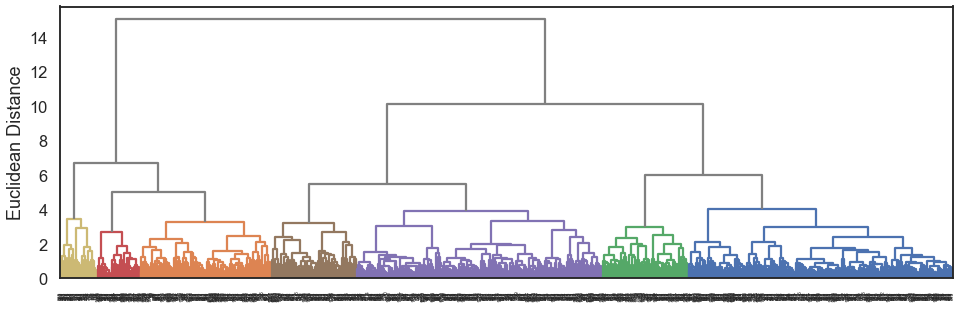

In [279]:
sns.set_style("white")
sns.despine()
sns.set_context("talk")
# from scipy.cluster import hierarchy
sns.color_palette('deep')


plt.figure(figsize=(16,5))
# a = plt.axes()
# plt.set_cmap('Accent')

hierarchy.set_link_color_palette(['C8', 'C3', 'C1', 'C5', 'C4', 'C2', 'C10', 'C9'])
color_threshold = 5 #.35*clusto.cluster.distances_.max()
R = hierarchy.dendrogram(linkage_matrix, color_threshold=color_threshold, above_threshold_color='gray',
                   distance_sort='ascending')#, truncate_mode='level', p=6) #, 
               #link_color_func=lambda x: link_cols[x]) 
plt.ylabel('Euclidean Distance')
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_dendrogram_meso.pdf', bbox_inches='tight')
plt.show()

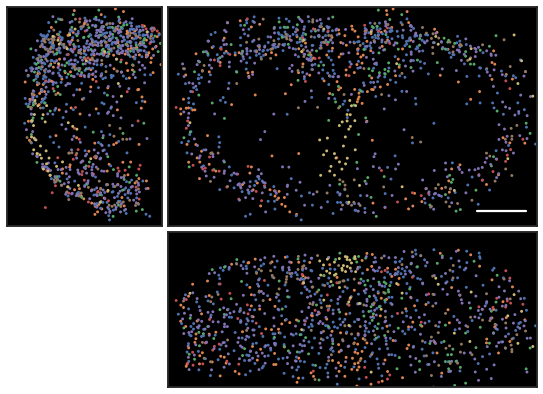

In [280]:
reload(plotting)
cIds = np.zeros(len(clusto.cluster.labels_))
u = np.unique(R['leaves_color_list'])
for idx,c in enumerate(u):
    matches = [i for i,x in enumerate(R['leaves_color_list']) if x == c]
    cIds[np.array(R['leaves'])[matches]] = idx

cmap = plotting.cmap_from_dendrogram(R) #plotting.cold_to_hot_cmap() #cm.get_cmap('rainbow')
plotting.show_colorCoded_cellMap_points(data_dict, cIds, cIds, cmap=cmap, pval=0.01, sort_by='val', color_lims_scale=[0,1])
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clustMap_meso.pdf', bbox_inches='tight')
plt.show()

In [281]:
# plotting.show_colorCoded_cellMap_points(data_dict, cIds, cIds, cmap=cmap, 
#                                         pval=0.01, sort_by='val', color_lims_scale=[0,1], point_size=20)
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clustMap_meso_bigpt.pdf', bbox_inches='tight')
# plt.show()

In [282]:
# grid_points = np.round(data_dict['dims_in_um']/5).astype(int)[[1,0,2]]
# grid_image_clust = plotting.get_model_as_dist(data_dict, 
#                                             cIds+1, 
#                                             grid_points=grid_points)

# cIdx = [i for i in range(int(cIds.max()))]
# cmap = plotting.cmap_from_dendrogram(R, color_idx=cIdx) #plotting.cold_to_hot_cmap() #cm.get_cmap('rainbow')
# c_range=np.array([0,cIds.max()])
# plotting.show_scaled_image(grid_image_clust, data_dict['dims_in_um'], c_range=c_range, 
#                            cmap=cmap, smoothing=0.05)
# # plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clustMap_meso_smooth.pdf', bbox_inches='tight')


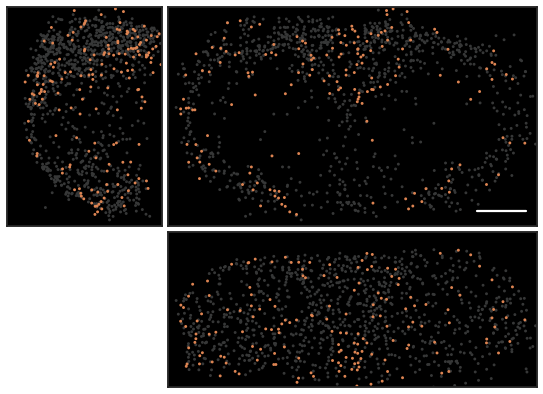

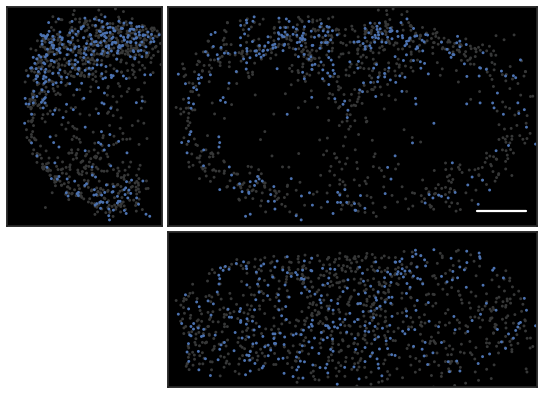

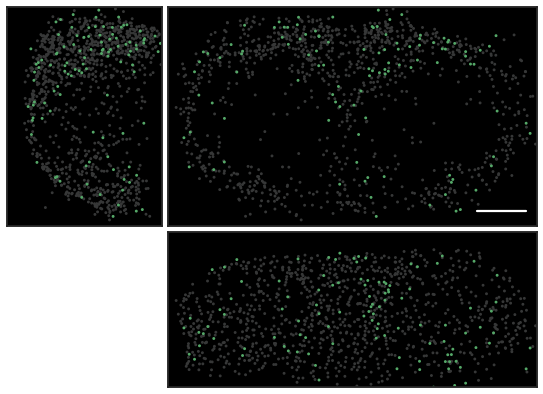

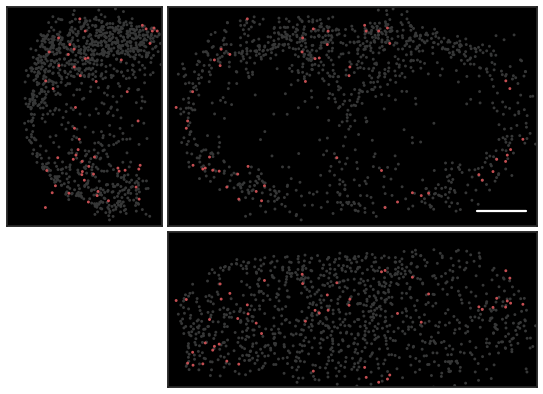

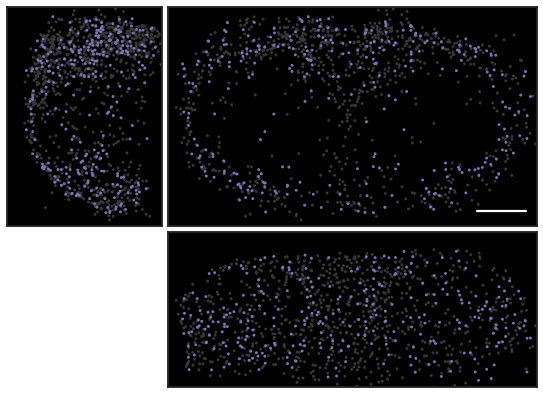

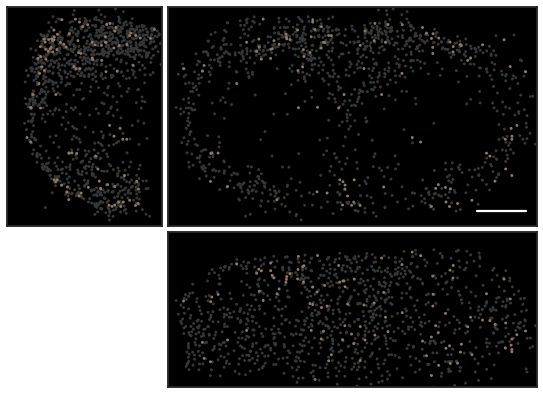

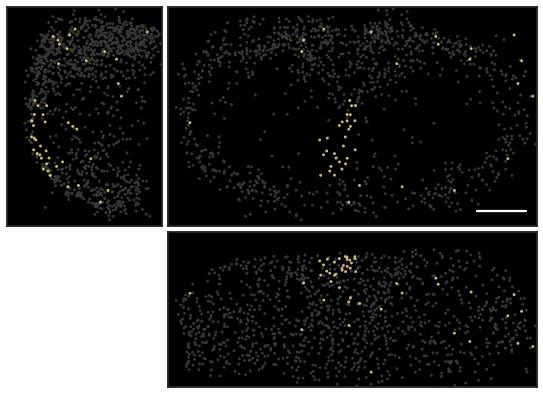

In [283]:
reload(plotting)
u = np.unique(R['leaves_color_list'])
for idx,c in enumerate(u):
    cIds = np.zeros(len(clusto.cluster.labels_))
    matches = [i for i,x in enumerate(R['leaves_color_list']) if x == c]
    cIds[np.array(R['leaves'])[matches]] = 1

    cmap = plotting.cmap_from_dendrogram(R, color_idx=idx) #plotting.cold_to_hot_cmap() #cm.get_cmap('rainbow')
    plotting.show_colorCoded_cellMap_points(data_dict, cIds, cIds, cmap=cmap, pval=0.01, sort_by='val', color_lims_scale=[0,1])
    plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clustMap_meso_idx_'+c+'.pdf', bbox_inches='tight')
    plt.show()

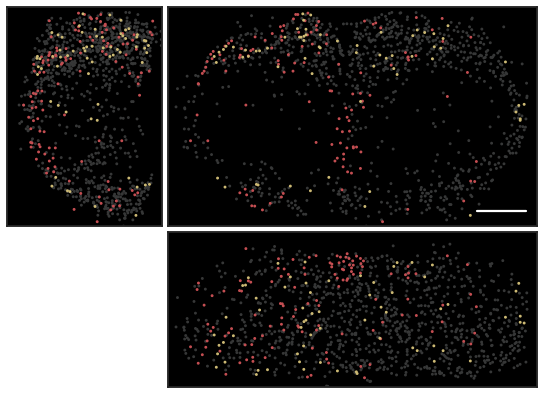

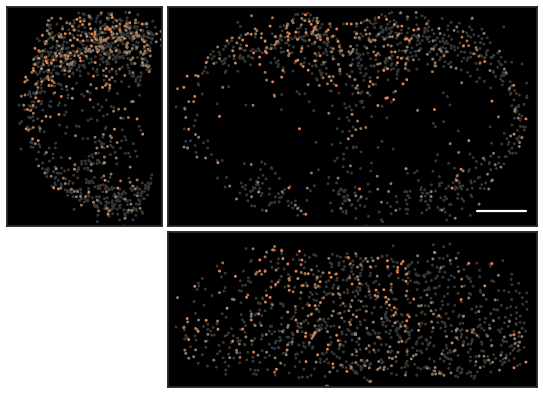

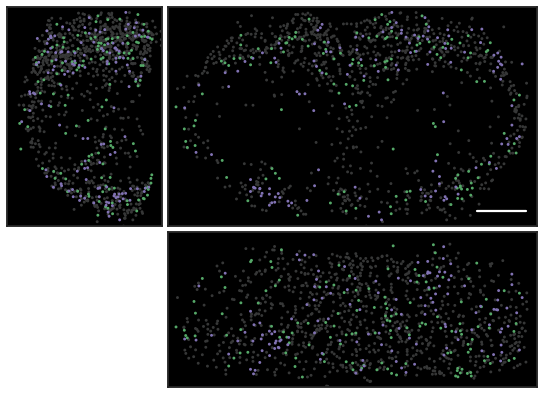

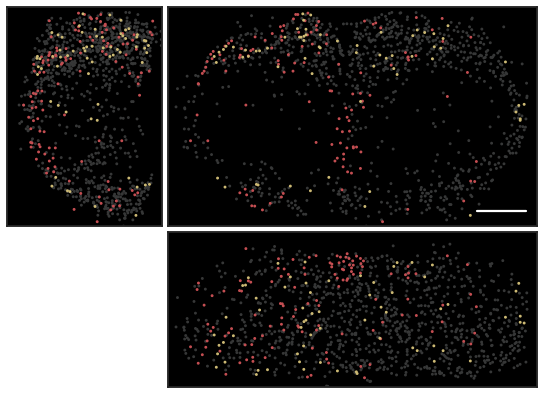

In [275]:
# show pairs
reload(plotting)
u = np.unique(R['leaves_color_list'])
pairs = [[3,6], [0,5], [2,4], [3,6]]
for p in pairs:
    cIds = np.zeros(len(clusto.cluster.labels_))
    for idx,c in enumerate(u[p]):
        matches = [i for i,x in enumerate(R['leaves_color_list']) if x == c]
        cIds[np.array(R['leaves'])[matches]] = idx+1

    cmap = plotting.cmap_from_dendrogram(R, color_idx=p) #plotting.cold_to_hot_cmap() #cm.get_cmap('rainbow')
    plotting.show_colorCoded_cellMap_points(data_dict, cIds, cIds, cmap=cmap, pval=0.01, sort_by='val', color_lims_scale=[0,1])
    plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clustMap_meso_idx_'+str(u[p])+'.pdf', bbox_inches='tight')
    plt.show()

In [52]:
u = np.unique(R['leaves_color_list'])
cc_array = np.zeros(len(u))
for idx,c in enumerate(u):
    # idx=2
    c = u[idx]

    matches = [i for i,x in enumerate(R['leaves_color_list']) if x == c]
    matches_cellId = np.array(R['leaves'])[matches]
    cc_mat = data_dict['dFF'][matches_cellId,:]@data_dict['dFF'][matches_cellId,:].T

    N = len(matches)
    cc_array[idx] = np.triu(cc_mat,1).sum()/((N-1)*N/2)

print(cc_array)
with open(fig_dirs['clustfig_folder']+expt_id+'_clust_dendrogram_meso_corrs.txt', 'w') as f:
    print('Correlation Coefficients of labeled groups (left to right)', file=f)
    print(cc_array, file=f)

[0.40943961 0.38238539 0.43401896 0.32415261 0.26266004 0.16907324
 0.45185319 0.41095997 0.1461919 ]


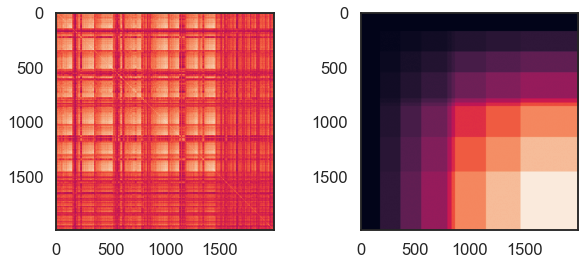

In [34]:
# sanity check: look at correlation matrix after organizing by group (structure is weak but ok)
dFF_tmp = np.zeros(data_dict['dFF'].shape)
blks = np.zeros(data_dict['dFF'].shape)
ctr = 0
for idx,c in enumerate(u):
    # idx=2
    c = u[idx]
    matches = [i for i,x in enumerate(R['leaves_color_list']) if x == c]
    matches_cellId = np.array(R['leaves'])[matches]
    dFF_tmp[ctr:ctr+len(matches)] = data_dict['dFF'][matches_cellId,:].copy()
    blks[ctr:ctr+len(matches)] = idx*np.ones(data_dict['dFF'][matches_cellId,:].shape)
    ctr+=len(matches)

plt.figure(figsize=(10,4))
plt.subplot(121)
cc = dFF_tmp@dFF_tmp.T
plt.imshow(cc)
plt.subplot(122)
cct = blks@blks.T
plt.imshow(cct)

### Via angular distance, for intuitive plotting

In [15]:
### hierarchical clustering on training data
clusto = flclust.flyg_clust_obj(data_dict)
clusto.get_clusters(affinity='cosine', linkage='complete', distance_threshold=0.15)  # hierarchical clustering


N clusters: 1178


In [16]:
color_threshold = .25*clusto.cluster.distances_.max()
linkage_matrix = clusto.get_linkage() 

<Figure size 432x288 with 0 Axes>

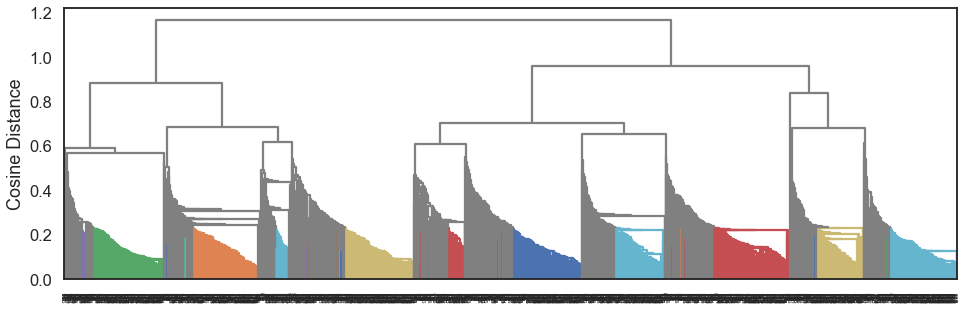

In [21]:
sns.set_style("white")
sns.despine()
sns.set_context("talk")
# from scipy.cluster import hierarchy
sns.color_palette('deep')


plt.figure(figsize=(16,5))
# a = plt.axes()
# plt.set_cmap('Accent')

hierarchy.set_link_color_palette(['C8', 'C1', 'C3', 'C4', 'C5', 'C2', 'C9', 'C10'])
color_threshold = .2*clusto.cluster.distances_.max()
R = hierarchy.dendrogram(linkage_matrix, color_threshold=color_threshold, above_threshold_color='gray',
                   distance_sort='ascending')#, truncate_mode='level', p=6) #, 
               #link_color_func=lambda x: link_cols[x]) 
plt.ylabel('Cosine Distance')
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_dendrogram_meso_angular.pdf', bbox_inches='tight')
plt.show()

# make summary plots

In [177]:
# reload(flclust)
# fig, (ax1) = plt.subplots(nrows=1, ncols=1, figsize=(8, 4))

# for nf in range(len(exp_list)):
#     expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
#     fig_dirs = futils.get_fig_dirs(expt_id)
#     data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
#     clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model.pkl', "rb" ) )

#     size_list = [2]
#     for i in range(len(size_list)):
#         to_plot = []
#         right_size_clust = clusto.n_clust_members[size_list[i]] 
#         for j in range(clusto.nClust):
#             if clusto.clust_is_sig[j]:
#                 if j in right_size_clust:
#                     to_plot.append(j) 

#         clusts_to_plot = clusto.clust_dist_score[to_plot]
#         ulm = 1.05*clusts_to_plot.max() 
#         parts = ax1.violinplot(
#             clusts_to_plot, positions=[nf], showmeans=False, showmedians=False,
#             showextrema=False)
#         for pc in parts['bodies']:
#             pc.set_facecolor('#0485d1')
#             pc.set_edgecolor('black')
#             pc.set_alpha(.6)

#         null_weights = np.ones_like(clusto.null_dist_score_beh[size_list[i]]) * len(clusts_to_plot)/len(clusto.null_dist_score_beh[size_list[i]])
#         parts = ax1.violinplot(
#             clusto.null_dist_score_beh[size_list[i]], positions=[nf], showmeans=False, showmedians=False,
#             showextrema=False)
#         for pc in parts['bodies']:
#             pc.set_facecolor('black')
#             pc.set_edgecolor('black')
#             pc.set_alpha(0.5)

# ax1.set_xlabel('Fly Number')
# ax1.set_ylabel('Spatial Order Score')
# # plt.savefig( dirs['results']+'_clust_dist_score_hist_summary.pdf',transparent=True, bbox_inches='tight')


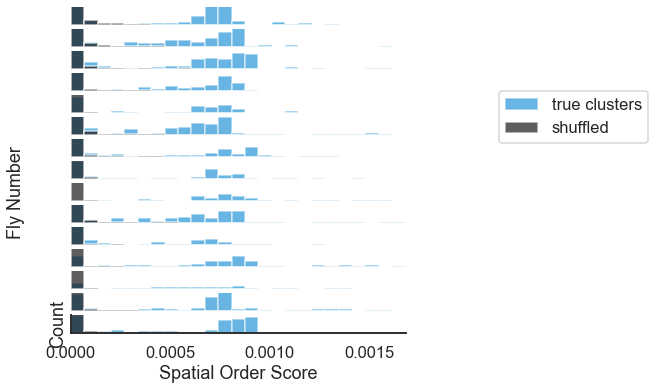

In [33]:
reload(flclust)
behav_null = False

fig, (ax1) = plt.subplots(nrows=len(exp_list), ncols=1, figsize=(6, 6))

for nf in range(len(exp_list)):
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    fig_dirs = futils.get_fig_dirs(expt_id)
    data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
    clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model_beh.pkl', "rb" ) )

    Csize = 2
    to_plot = []
    right_size_clust = clusto.n_clust_members[Csize] 
    for j in range(clusto.nClust):
        if clusto.clust_is_sig[j]:
            if j in right_size_clust:
                to_plot.append(j) 

    clusts_to_plot = clusto.clust_dist_score[to_plot]
    if nf==0:
        ulm = 1.05*clusts_to_plot.max() 
    ax1[nf].hist(clusts_to_plot,25,(0,ulm),color='#0485d1',alpha=.6,label='true clusters')
    if behav_null:
        null_weights = np.ones_like(clusto.null_dist_score_beh[Csize]) * len(clusts_to_plot)/len(clusto.null_dist_score_beh[Csize])
        ax1[nf].hist(clusto.null_dist_score_beh[Csize],25,(0,ulm),weights=null_weights,color='k',alpha=.7,label='beh. matched shuffled')
    else:
        null_weights = np.ones_like(clusto.null_dist_score[Csize]) * len(clusts_to_plot)/len(clusto.null_dist_score[Csize])
        ax1[nf].hist(clusto.null_dist_score[Csize],25,(0,ulm),weights=null_weights,color='k',alpha=.7,label='shuffled')
    if nf==len(exp_list)-1:
        plt.xlabel('Spatial Order Score') 
    ax1[nf].set_xlim(0,ulm)
    
    ax1[nf].set_ylim(0,20) 
    ax1[nf].set_yticks([]) 
    if nf==len(exp_list)-1:
        ax1[nf].spines['top'].set_visible(False)
        ax1[nf].spines['right'].set_visible(False)
        #ax1[nf].spines['bottom'].set_visible(False)
        #ax1[nf].spines['left'].set_visible(False)
        ax1[nf].set_ylabel('Count')
    elif nf==round(len(exp_list)/2):
        ax1[nf].spines['top'].set_visible(False)
        ax1[nf].spines['right'].set_visible(False)
        ax1[nf].spines['bottom'].set_visible(False)
        ax1[nf].spines['left'].set_visible(False)
        ax1[nf].set_xticks([])
        ax1[nf].set_ylabel('Fly Number\n\n')
    else:
        ax1[nf].axis('off')
    

ax1[5].legend(bbox_to_anchor=(1.75, 1), loc='right')
plt.savefig( dirs['results']+'_clust_dist_score_hist_summary_beh.pdf',transparent=True, bbox_inches='tight')


## do Kolmogorov-Smirnov test instead of KL divergence of size 2 clusters

In [64]:
from scipy.stats import ks_2samp
ks_2samp(clusts_to_plot, clusto.null_symmetry[size_list[i]]) #, alternative='greater')

Ks_2sampResult(statistic=0.972, pvalue=1.0967913335498109e-12)

# make example plots

In [34]:
nf=-1
reload(flclust)
expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
fig_dirs = futils.get_fig_dirs(expt_id)
data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model_beh.pkl', "rb" ) )

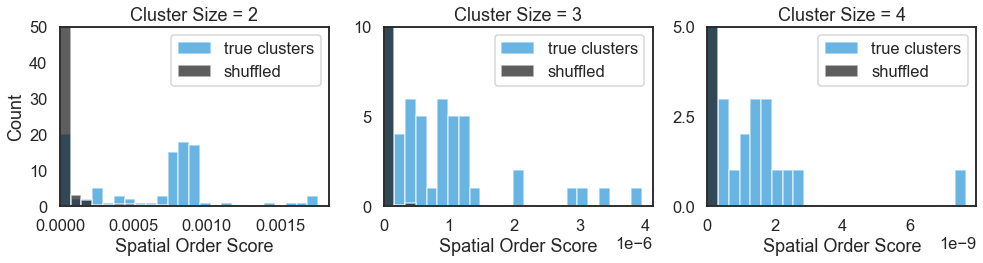

In [35]:
clusto.make_summary_plot(behav_null=False)
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_dist_score_hist_beh.pdf',transparent=True, bbox_inches='tight')


#### summary of simple clusters

In [49]:
reload(flclust)
f = np.zeros(len(exp_list))
p = [None]*len(exp_list)
for nf in range(len(exp_list)):
    print(nf,end=' ')

    # load processed data
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    #data_dict_raw = dataUtils.load_timeseries_simple(exp_list[nf][0], exp_list[nf][1], dirs['data'])
    fig_dirs = futils.get_fig_dirs(expt_id)

    data_dict = summary_dict_tot[nf]['data_dict']
    #data_dict['dFF'] = data_dict['dFF_resid_base']

    ### hierarchical clustering on training data
    remake_clusters = True
    clusto = flclust.flyg_clust_obj(data_dict)
    clusto.get_clusters()            # hierarchical clustering

    clusto.data_dict['dFF_resid_renorm'], mu, sig = clusto.normalize_rows_euc(data_dict['dFF'])                                
    clusto.get_simple_clusters(activity='dFF_resid_renorm') # corr-based clustering
    
    lp = 2*len(clusto.simple_clust['pairs'])

    f[nf] = lp/clusto.data_dict['dFF_resid_renorm'].shape[0]
    
    p[nf] = clusto.get_simple_clust_popularity()


0 N clusters: 1065
N clusters (simple): 314
1 N clusters: 1133
N clusters (simple): 274
2 N clusters: 1288
N clusters (simple): 241
3 N clusters: 942
N clusters (simple): 208
4 N clusters: 847
N clusters (simple): 117
5 N clusters: 1289
N clusters (simple): 274
6 N clusters: 879
N clusters (simple): 197
7 N clusters: 813
N clusters (simple): 165
8 N clusters: 1000
N clusters (simple): 181
9 N clusters: 1263
N clusters (simple): 209
10 N clusters: 1020
N clusters (simple): 170
11 N clusters: 743
N clusters (simple): 176
12 N clusters: 364
N clusters (simple): 73
13 N clusters: 1213
N clusters (simple): 293
14 N clusters: 1129
N clusters (simple): 384


In [51]:
dim_summary = []
for nf in range(len(exp_list)):
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    data_dict = summary_dict_tot[nf]['data_dict']
    M_hat = (data_dict['dFF'].shape[0]/1000)*((f[nf]-0.1)/0.027)**2
    dim_summary.append( {'expt_id':expt_id, 'M_hat':M_hat} )

In [52]:
print('Mean fraction in simple clusters is '+str(f.mean()))

Mean fraction in simple clusters is 0.3071447335457908


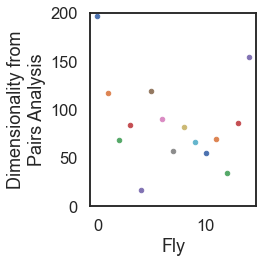

In [58]:
plt.figure(figsize=(4,4))
for nf in range(len(exp_list)):
    #print(nf, dim_summary[nf]['expt_id'])
    plt.plot(nf,dim_summary[nf]['M_hat'],'.')
plt.ylim(0,200)
plt.xlabel('Fly')
plt.ylabel('Dimensionality from\nPairs Analysis')
plt.tight_layout()
plt.savefig( dirs['results']+'_simple_clust_dimensionality.pdf',transparent=True, bbox_inches='tight')
plt.show()

In [61]:
# validate estimated dimensionality
for nf in range(len(exp_list)):
    M = dim_summary[nf]['M_hat'].astype(int)
    N = summary_dict_tot[nf]['data_dict']['dFF'].shape[0]
    T = 10000

    dFF_hub = np.random.normal(0,100,(M,T))

    dFF = np.random.normal(0,1,(N,T))
    for n in range(N):
        dFF[n,:] += dFF_hub[ np.mod(n,M), :]
        dFF[n,:] -= dFF[n,:].mean()
        dFF[n,:] /= (dFF[n,:].std()*np.sqrt(T))
        
    aligned_centroids = np.random.rand(N,3)
    data_dict = {'dFF':dFF, 'aligned_centroids':aligned_centroids}
    clusto = flclust.flyg_clust_obj(data_dict)
    clusto.get_simple_clusters(activity='dFF') # corr-based clustering

    lp = 2*len(clusto.simple_clust['pairs'])
    f_hat = lp/N
    print(f[nf], f_hat)

N clusters (simple): 305
0.4028223220012829 0.39127645926876203
N clusters (simple): 286
0.3246445497630332 0.33886255924170616
N clusters (simple): 252
0.26615129762562123 0.27829928216454997
N clusters (simple): 211
0.3161094224924012 0.32066869300911854
N clusters (simple): 122
0.20418848167539266 0.21291448516579406
N clusters (simple): 275
0.3277511961722488 0.32894736842105265
N clusters (simple): 194
0.336464560204953 0.33134073441502987
N clusters (simple): 173
0.291005291005291 0.30511463844797176
N clusters (simple): 181
0.3348751156336725 0.3348751156336725
N clusters (simple): 209
0.2792251169004676 0.2792251169004676
N clusters (simple): 182
0.28286189683860236 0.30282861896838603
N clusters (simple): 169
0.31150442477876106 0.2991150442477876
N clusters (simple): 73
0.34515366430260047 0.34515366430260047
N clusters (simple): 292
0.27004608294930876 0.26912442396313363
N clusters (simple): 394
0.3143675808432255 0.32255423659435123


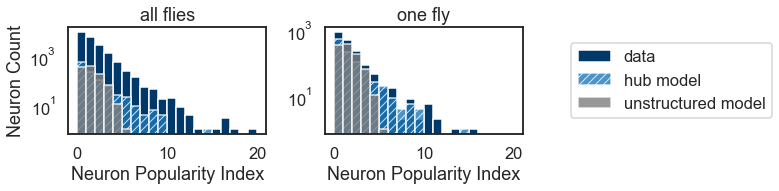

In [247]:
p_flat = []
[p_flat.extend(p[i]) for i in range(len(p))]
p_flat = np.array(p_flat)
bins = [i for i in range(int(p_flat.max())+1)]

plt.figure(figsize=(14,3))
plt.subplot(121)
plt.hist(p_flat,bins, color='#01386a', label='data')
plt.hist(p_hubs,bins,alpha=.8, color='tab:blue', hatch='///', label='hub model')
plt.hist(p_rand,bins,alpha=.8, color='tab:gray', label='unstructured model')
plt.yscale('log')
# plt.legend()
plt.xlabel('Neuron Popularity Index')
plt.ylabel('Neuron Count')
plt.title('all flies')

nf=2
plt.subplot(122)
plt.hist(p[nf],bins, color='#01386a', label='data')
plt.hist(p_hubs,bins,alpha=.8, color='tab:blue', hatch='///', label='hub model')
plt.hist(p_rand,bins,alpha=.8, color='tab:gray', label='unstructured model')
plt.yscale('log')
plt.legend(bbox_to_anchor=(2.3, .5), loc='right')
plt.xlabel('Neuron Popularity Index')
plt.title('one fly')

plt.tight_layout()
plt.savefig( dirs['results']+'_simple_clust_popularity_score.pdf',transparent=True, bbox_inches='tight')
plt.show()

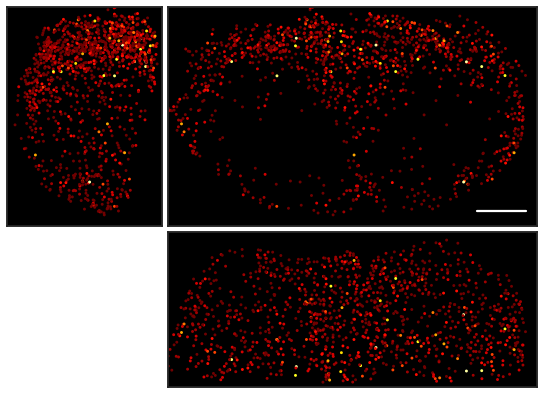

In [177]:
nf=-5
expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
fig_dirs = futils.get_fig_dirs(expt_id)
data_dict = summary_dict_tot[nf]['data_dict']
plot_param = p[nf]

_ = plotting.show_colorCoded_cellMap_points(data_dict, None, plot_param, cmap=plotting.make_hot_without_black(), pval=0.01, color_lims_scale=[0,.8])


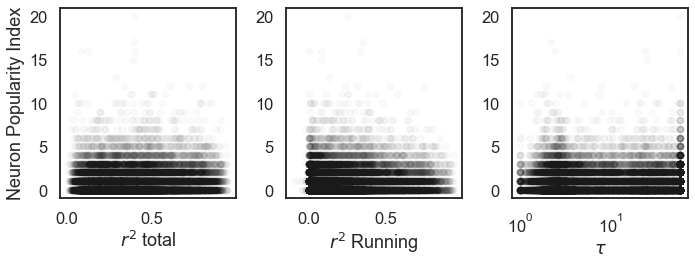

In [250]:
plt.figure(figsize=(10,4))
plt.subplot(131)
for nf in range(len(p)):
    plt.scatter( summary_dict_tot[nf]['rsq']['tot'], p[nf], s=40,alpha=.02,color='k' )
plt.xlabel('$r^2$ total')
plt.ylabel('Neuron Popularity Index')

plt.subplot(132)
for nf in range(len(p)):
    plt.scatter( summary_dict_tot[nf]['rsq']['beta_0'], p[nf], s=40,alpha=.02,color='k' )
plt.xlabel('$r^2$ Running')

plt.subplot(133)
for nf in range(len(p)):
    plt.scatter( summary_dict_tot[nf]['f']['tau'], p[nf], s=40,alpha=.02,color='k' )
plt.xlabel(r'$\tau$')
plt.xscale('log')
plt.tight_layout()
plt.savefig( dirs['results']+'_simple_clust_popularity_vs_reg_vals.pdf',transparent=True, bbox_inches='tight')
plt.show()


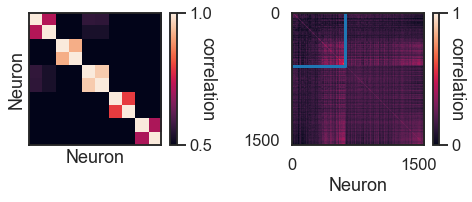

In [96]:
# show correlation matrices
CO = clusto.simple_clust['C_ord'].copy()
lp = 2*len(clusto.simple_clust['pairs'])

plt.figure(figsize=(7,3))
plt.subplot(121)
refpt = 10
im = plt.imshow(CO[:refpt,:refpt])
im.set_clim(.5,1)
plt.ylabel('Neuron')
plt.xlabel('Neuron')
plt.xticks([])
plt.yticks([])
cbar=plt.colorbar(ticks=[.5,1])
cbar.set_label('correlation\n', rotation=270)


plt.subplot(122)
im=plt.imshow(CO)
im.set_clim(0.0,1.0)
plt.plot([0,lp],[lp,lp],'tab:blue',lw=3)
plt.plot([lp,lp],[0,lp],'tab:blue',lw=3)
plt.xlabel('Neuron')
l = int(np.floor(CO.shape[0] / 100.0)) * 100
plt.xticks([0,l])
plt.yticks([0,l])
cbar=plt.colorbar(ticks=[0,1])
cbar.set_label('correlation\n', rotation=270)
plt.tight_layout()
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_pairwise_cluster_summ.pdf',transparent=True, bbox_inches='tight')
plt.show()

### testing null simple cluster dist

In [99]:
# Highly structured, with true clusters of size M

N = 1000 # number of cells
M = 4  # size of true meso-clusters
iters = 100 #5000
count = np.zeros(iters)

idgrid = np.zeros((M,M-1))
for j in range(M):
    idgrid[j,:] = [i for i in range(M) if i!=j]

for j in range(iters):
    tmp = np.random.randint(low=0, high=M-1, size=M)
    x = np.array([idgrid[i,tmp[i]] for i in range(M)]).astype(int)
    tmp = np.random.randint(low=0, high=M-1, size=M)
    y = np.array([idgrid[i,tmp[i]] for i in range(M)]).astype(int)
    for i in range(M):
        if (y[x[i]] == i) and (x[i]>y[x[i]]):
            # only count 1 cluster per pair
            count[j] += 1

k = N/M*count.mean()
print('Observed clusters = '+str(k))
print('Expected clusters = '+str((N/2)/(M-1)))

f = N/k
M_hat = (f/2)+1
print('M_hat = '+str(M_hat))
print('Expected cluster dimensions (D) = '+str(N/M_hat))

Observed clusters = 165.0
Expected clusters = 166.66666666666666
M_hat = 4.03030303030303
Expected cluster dimensions (D) = 248.1203007518797


In [100]:
N=1500
K=0.31*N
M_hat = (N+2*K)/(2*K)
print('M_hat = '+str(M_hat))
print('Expected cluster dimensions (D) = '+str(N/M_hat))

M_hat = 2.6129032258064515
Expected cluster dimensions (D) = 574.0740740740741


## visualizing regression parameters with clusters

In [496]:
# tau scatter with clusters
nf=0

expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
fig_dirs = futils.get_fig_dirs(expt_id)
data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model.pkl', "rb" ) )

reload(plotting)
ro = model.reg_obj(activity='dFF', data_dict=copy.deepcopy(data_dict))
ro.model_fit = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+ro.activity+'_ols_reg_model_whole_1p0.pkl', "rb" ) )
ro.model_fit_shifted = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+ro.activity+'_ols_reg_model_shifted_whole_1p0.pkl', "rb" ) )
ro.downsample_in_time()
ro.get_model_sig_from_shifted_fit(param='tau', sig_th=0.2)
f = plotting.get_model_fit_as_dict(ro.model_fit)
cc = plotting.get_model_fit_as_dict(f['cc'])

In [537]:
# not sig -> skip
# sig -> not sig
# just_clust_idx -> sig
th=0.2
reg_model_with_clust = []
for i in range(len(ro.model_fit)):
    if f['stat'][i]['tau'][0][1]<th:
        reg_model_with_clust.append( copy.deepcopy(ro.model_fit[i]) )
        if i in np.flatnonzero(just_clust_idx):
            reg_model_with_clust[-1]['stat']['tau'] = [[0,0]]
            reg_model_with_clust[-1]['stat']['beta_0'] = [[0,0]]
        else:
            reg_model_with_clust[-1]['stat']['tau'] = [[1,1]]
            reg_model_with_clust[-1]['stat']['beta_0'] = [[1,1]]
        

median tau of significant cells = 3.3253254645956307
frac of significant cells w/ tau above 20s = 0.13793103448275862
fraction of cells with p<0.2 = 0.07178217821782178


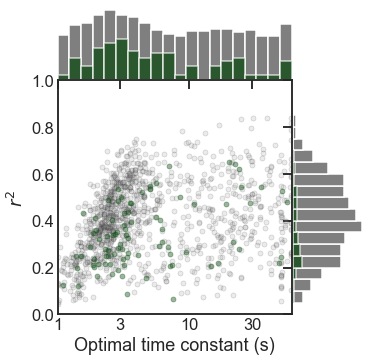

In [538]:
plotting.show_tau_scatter(reg_model_with_clust, pval=.2, sig_clr='#06470c')
plt.savefig(fig_dirs['clustfig_folder'] + expt_id +'_tauScatter_withClust.pdf',transparent=True, bbox_inches='tight')


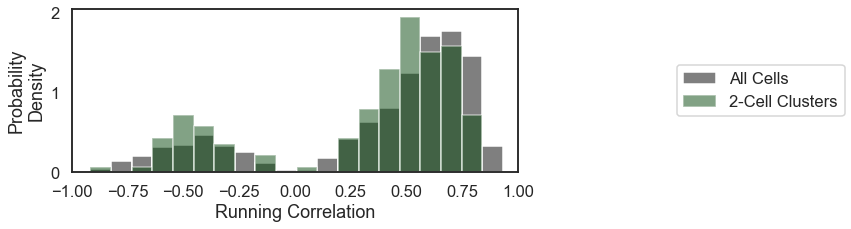

In [583]:
# not sig -> skip
# sig -> not sig
# just_clust_idx -> sig
th=0.2

plt.figure(figsize=(8,3))
n_xbins=20
n_ybins=20
sig_clr='#06470c'
ftmp = plotting.get_model_fit_as_dict(ro.model_fit)
cctmp = plotting.get_model_fit_as_dict(ftmp['cc'])
param=cctmp['beta_0']

param_inclust = param[just_clust_idx]
param_notinclust = param[np.logical_not(just_clust_idx)]
xmin = param.min() #np.floor(param.min()) #4/scanRate
xmax = param.max() #np.ceil(param.max()) #30 #1000/scanRate #6000
xbinwidth = (xmax-xmin)/n_xbins
xbins = np.arange(xmin, xmax+xbinwidth, xbinwidth) #np.logspace(np.log(xmin), np.log(xmax),num=len(ybins),base=np.exp(1))
plt.hist(param_notinclust, bins=xbins,color='tab:gray', density=True, label='All Cells') #'#929591')
plt.hist(param_inclust, bins=xbins,color=sig_clr,alpha=.5, density=True, label='2-Cell Clusters') #'#929591')
plt.xlim(-1,1)
plt.ylabel('Probability\nDensity')
plt.xlabel('Running Correlation')
plt.legend(bbox_to_anchor=(1.75, .5), loc='right')
# plt.gca().fontsize=18
# plt.tight_layout()
plt.savefig(fig_dirs['clustfig_folder'] + expt_id +'_beta_0_CC_Hist_withClust.pdf',transparent=True, bbox_inches='tight')
plt.show()

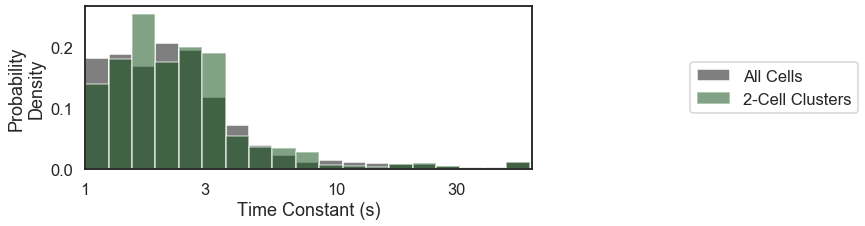

In [577]:
# not sig -> skip
# sig -> not sig
# just_clust_idx -> sig
th=0.2

plt.figure(figsize=(8,3))
n_xbins=20
n_ybins=20
sig_clr='#06470c'
ftmp = plotting.get_model_fit_as_dict(ro.model_fit)
param=ftmp['tau']

param_inclust = param[just_clust_idx]
param_notinclust = param[np.logical_not(just_clust_idx)]
xmin = param.min() #np.floor(param.min()) #4/scanRate
xmax = param.max() #np.ceil(param.max()) #30 #1000/scanRate #6000

xbins = np.logspace(np.log10(xmin), np.log10(xmax),num=n_xbins, base=10) #np.exp(1))
plt.hist(param_notinclust, bins=xbins,color='tab:gray', density=True, label='All Cells') #'#929591')
plt.hist(param_inclust, bins=xbins,color=sig_clr,alpha=.5, density=True, label='2-Cell Clusters') #'#929591')
plt.xscale('log')
plt.xticks((1,3,10,30), labels=('1','3','10','30'))
plt.xlim(1,60)
plt.ylabel('Probability\nDensity')
plt.xlabel('Time Constant (s)')
plt.legend(bbox_to_anchor=(1.75, .5), loc='right')
# plt.tight_layout()
plt.savefig(fig_dirs['clustfig_folder'] + expt_id +'_tauHist_withClust.pdf',transparent=True, bbox_inches='tight')
plt.show()

## visualizing large clusters & projections


In [341]:
cell_mat_aligned = pickle.load( open(dirs['data']+'_summary/'+"cell_mat_aligned.pkl","rb"))


In [342]:
cell_mat_aligned.keys()

dict_keys(['cellmap_aligned', 'tseries_aligned'])

In [ ]:
# # import hyperaligned modes

# # tmp_data_sum = pickle.load( open(dirs['data']+"data_summary_py2.pkl","rb") )
# data_sum_for_py2 = pickle.load( open(dirs['data']+"data_summary_proc_py2.pkl","rb") )

# n_flies = len(data_sum_for_py2)
# pattern_mat_aligned = []
# for nf in range(n_flies):
#     pattern_mat_aligned.append( np.array(data_sum_for_py2[nf]) )

# # aligned_model = {'R_list':R_list, 'tseries_aligned':tseries_aligned}
# aligned_model = pickle.load( open(dirs['data']+"aligned_model.pkl","rb") )

# # project all cells onto (first two?) aligned temporal components
# al_mod = aligned_model['tseries_aligned'][2] #[sl,:]
# W = np.zeros((dict_temp['dFF'].shape[0],2))
# nu = al_mod[:,:2]
# nu_proj = np.linalg.inv(nu.T@nu)@nu.T
# for i in range(dict_temp['dFF'].shape[0]):
#     W[i,:] = nu_proj@dict_temp['dFF'][i,:]

# # project all cells onto (all?) aligned temporal components
# al_mod = aligned_model['tseries_aligned'][2] #[sl,:]
# Wa = np.zeros((dict_temp['dFF'].shape[0],al_mod.shape[1]))
# nu = al_mod
# nu_proj = np.linalg.inv(nu.T@nu)@nu.T
# for i in range(dict_temp['dFF'].shape[0]):
#     Wa[i,:] = nu_proj@dict_temp['dFF'][i,:]

In [489]:
nf=0

expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
fig_dirs = futils.get_fig_dirs(expt_id)
data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model.pkl', "rb" ) )

# plot_param = cell_mat_aligned['cellmap_aligned'][nf][:,0] 
# plotting.show_colorCoded_cellMap_points(data_dict, None, plot_param, cmap=plotting.cold_to_hot_cmap(), pval=0.01, color_lims_scale=[-1,1])
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_vs_clusters_kmeans_locRef.pdf',transparent=False, bbox_inches='tight')

In [482]:
model_retrofit = []
param = cell_mat_aligned['cellmap_aligned'][nf][:,0]
param2 = cell_mat_aligned['cellmap_aligned'][nf][:,1]
param7 = cell_mat_aligned['cellmap_aligned'][nf][:,6]
param8 = cell_mat_aligned['cellmap_aligned'][nf][:,7]
for i in range(cell_mat_aligned['cellmap_aligned'][nf].shape[0]):
    model_retrofit.append( {'Mode 1':param[i], 'Mode 2':param2[i], 'Mode 7':param7[i], 'Mode 8':param8[i]} )
    model_retrofit[i]['r_sq'] = {'Mode 1':param[i], 'Mode 2':param2[i], 'Mode 7':param7[i], 'Mode 8':param8[i]}
    model_retrofit[i]['cc'] = {'Mode 1':param[i], 'Mode 2':param2[i], 'Mode 7':param7[i], 'Mode 8':param8[i]}
    model_retrofit[i]['stat'] = {'Mode 1':[[0,1]], 'Mode 2':[[0,1]], 'Mode 7':[[0,1]], 'Mode 8':[[0,1]]}

In [ ]:
# beta_cc scatter with clusters
reload(plotting)
# pdb.set_trace()
# param_label = param[0]+'_'+str(param[1])+param2[0]+'_'+str(param2[1])
plotting.show_param_scatter(model_retrofit, None, 'Mode 1')
plt.savefig(fig_dirs['clustfig_folder'] +expt_id+'_Beta_0_CC_Scatter_withClust.pdf',transparent=True, bbox_inches='tight')


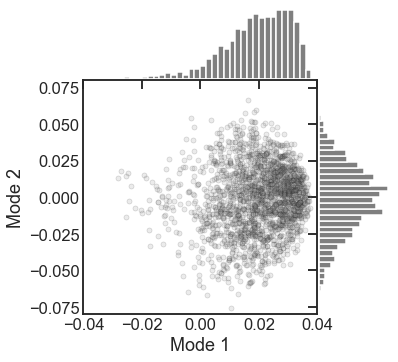

In [486]:
# make composite scatter
reload(plotting)
# pdb.set_trace()
# param_label = param[0]+'_'+str(param[1])+param2[0]+'_'+str(param2[1])
plotting.show_param_scatter(model_retrofit, None, 'Mode 1', param2_input='Mode 2', xlim=[-.04,.04], ylim=[-.08,.08])
plt.savefig(fig_dirs['pcfig_folder'] +expt_id+'_Mode_1v2_Scatter.pdf',transparent=True, bbox_inches='tight')


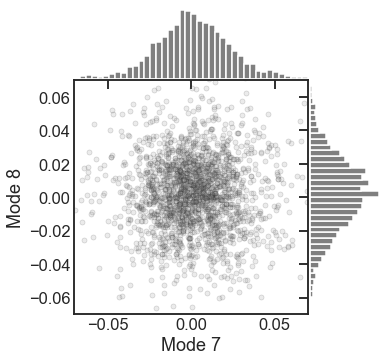

In [487]:
# make composite scatter
reload(plotting)
# pdb.set_trace()
# param_label = param[0]+'_'+str(param[1])+param2[0]+'_'+str(param2[1])
plotting.show_param_scatter(model_retrofit, None, 'Mode 7', param2_input='Mode 8', xlim=[-.07,.07], ylim=[-.07,.07])
plt.savefig(fig_dirs['pcfig_folder'] +expt_id+'_Mode_7v8_Scatter.pdf',transparent=True, bbox_inches='tight')


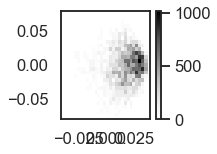

In [426]:
from matplotlib import colors as clrs
plt.figure(figsize=(2,2))
param = cell_mat_aligned['cellmap_aligned'][nf][:,0]
param2 = cell_mat_aligned['cellmap_aligned'][nf][:,1]
h, xedges, yedges, image = plt.hist2d(param, param2, bins=25, cmap='Greys', density=True)
# plt.clim(0,15)
plt.xlim(-.04,.04)
plt.ylim(-.08,.08)
plt.colorbar()
plt.show()

In [429]:
# checking normalization
h.sum()*np.diff(xedges)[0]*np.diff(yedges)[0]

0.9999999999999996

In [391]:
# replace original cluster indices with new indices 0,1,2, to use colormap equally
agg_clusters = clusto.agg_clusters
just_clust_idx = agg_clusters>-1
agg_clust_colors = np.zeros(agg_clusters[just_clust_idx].shape)
u = np.unique(agg_clusters[just_clust_idx])
for i in enumerate(u):
    is_this_clust_tmp = np.flatnonzero(agg_clusters[just_clust_idx]==i[1])
    agg_clust_colors[is_this_clust_tmp] = i[0] 
   

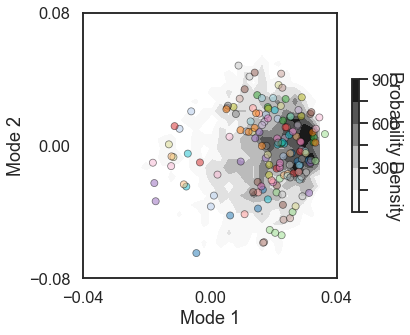

In [433]:
plt.figure(figsize=(6,5))
hplt = h.T
# hplt[hplt>8]=8
hplt[hplt>900]=900
plt.contourf(xedges[:-1], yedges[:-1], hplt, levels=[50,150,300,450,600,750,900],cmap='Greys',vmax=900)
cbar = plt.colorbar(shrink=.5) 
cbar.ax.set_yticklabels(['','','300','','600','','900']) 
cbar.set_label('Probability Density', rotation=270)

plt.scatter(param[just_clust_idx], param2[just_clust_idx],s=50,alpha=.5,linewidths=0.75,edgecolors='k',
            c=agg_clust_colors, cmap='tab20') #, c=tab20)

plt.xlim(-.04,.04)
plt.ylim(-.08,.08)
plt.xticks([-.04,0,.04])
plt.yticks([-.08,0,.08])
plt.xlabel('Mode 1')
plt.ylabel('Mode 2')
plt.tight_layout()
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_vs_agg_clusters.pdf',transparent=True, bbox_inches='tight')

### Mode 7&8 (py 6&7)

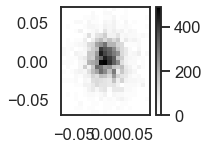

In [453]:
from matplotlib import colors as clrs
plt.figure(figsize=(2,2))
param7 = cell_mat_aligned['cellmap_aligned'][nf][:,6]
param8 = cell_mat_aligned['cellmap_aligned'][nf][:,7]
h, xedges, yedges, image = plt.hist2d(param7, param8, bins=25, cmap='Greys', density=True)
# plt.clim(0,15)
plt.xlim(-.07,.07)
plt.ylim(-.07,.07)
plt.colorbar()
plt.show()

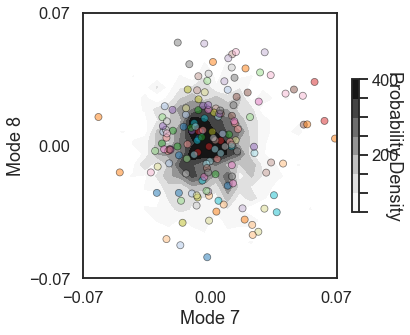

In [445]:
plt.figure(figsize=(6,5))
hplt = h.T
# hplt[hplt>8]=8
hplt[hplt>400]=400
plt.contourf(xedges[:-1], yedges[:-1], hplt, levels=[50,100,150,200,250,300,350,400],cmap='Greys',vmax=400)
cbar = plt.colorbar(shrink=.5) 
cbar.ax.set_yticklabels(['','','','200','','','','400']) 
cbar.set_label('Probability Density', rotation=270)

plt.scatter(param7[just_clust_idx], param8[just_clust_idx],s=50,alpha=.5,linewidths=0.75,edgecolors='k',
            c=agg_clust_colors, cmap='tab20') #, c=tab20)

plt.xlim(-.07,.07)
plt.ylim(-.07,.07)
plt.xticks([-.07,0,.07])
plt.yticks([-.07,0,.07])
plt.xlabel('Mode 7')
plt.ylabel('Mode 8')
plt.tight_layout()
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_vs_agg_clusters_7v8.pdf',transparent=True, bbox_inches='tight')

### version with sampling rather than all clusters


In [403]:
# version with sampling rather than all clusters
n_cluster_samples = 30
sample_list = np.random.randint(0, len(u), size=n_cluster_samples) 
clust_samples = u[sample_list]
tmp = [(i,i) for i in range(len(clust_samples))] 
agg_clust_outl_colors = [item for sublist in tmp for item in sublist]
sample_clust_cell_ids = np.zeros(2*len(clust_samples)) 
for i in enumerate(clust_samples):
    sample_clust_cell_ids[2*i[0]:2*(i[0]+1)] = np.flatnonzero(agg_clusters==i[1]) 
    
sample_clust_cell_ids = sample_clust_cell_ids.astype(int)

In [ ]:
plt.figure(figsize=(6,5))
hplt = h.T
hplt[hplt>20]=20
plt.contourf(xedges[:-1], yedges[:-1], hplt, levels=[1,2.5,5,7.5,10,12.5,15,17.5, cbar = plt.colorbar(shrink=.5) cbar.ax.set_yticklabels(['','','5','','10','','15','','20']) cbar.set_label('Probability Density', rotation=270) plt.scatter(Wa[sample_clust_cell_ids, 0], Wa[sample_clust_cell_ids, 1],s=50,alpha
c=agg_clust_outl_colors, cmap='tab20') #, c=tab20) plt.ylim(-.1,.05)
plt.xlim(-.02,.05)
plt.yticks([-.1,-.05,0,.05])
plt.xticks([-.02,0,.02,.04])
plt.xlabel('Mode 1')
plt.ylabel('Mode 2')
plt.tight_layout() plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_vs_agg_clusters_sampled.pdf

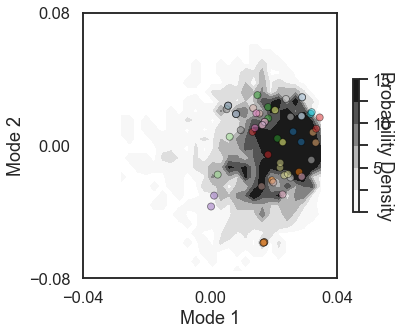

In [411]:
plt.figure(figsize=(6,5))
hplt = h.T
# hplt[hplt>8]=8
hplt[hplt>15]=15
plt.contourf(xedges[:-1], yedges[:-1], hplt, levels=[.5,2.5,5,7.5,10,12.5,15],cmap='Greys',vmax=15)
cbar = plt.colorbar(shrink=.5) 
cbar.ax.set_yticklabels(['','','5','','10','','15']) 
cbar.set_label('Probability Density', rotation=270)

plt.scatter(param[sample_clust_cell_ids], param2[sample_clust_cell_ids],s=50,alpha=.5,linewidths=0.75,edgecolors='k',
            c=agg_clust_outl_colors, cmap='tab20') #, c=tab20)

plt.xlim(-.04,.04)
plt.ylim(-.08,.08)
plt.xticks([-.04,0,.04])
plt.yticks([-.08,0,.08])
plt.xlabel('Mode 1')
plt.ylabel('Mode 2')
plt.tight_layout()
plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_vs_agg_clusters_sampled.pdf',transparent=True, bbox_inches='tight')

### example clusters

In [456]:
nf=2

expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
fig_dirs = futils.get_fig_dirs(expt_id)
data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model.pkl', "rb" ) )
model_fit = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dFF_ols_reg_model_whole_1p0.pkl', "rb" ) )
f = plotting.get_model_fit_as_dict(model_fit)
cc = plotting.get_model_fit_as_dict(f['cc'])
# plot_param = cell_mat_aligned['cellmap_aligned'][nf][:,0] 
# plotting.show_colorCoded_cellMap_points(data_dict, None, plot_param, cmap=plotting.cold_to_hot_cmap(), pval=0.01, color_lims_scale=[-1,1])
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_vs_clusters_kmeans_locRef.pdf',transparent=False, bbox_inches='tight')

In [468]:
f['tau'][57], cc['beta_0'][57]

(5.395572085271079, 0.25147647909000126)

In [476]:
round(f['tau'][57],2), round(cc['beta_0'][57],2)

(5.4, 0.25)

In [472]:
test = ''
test +='stuff'
test +='stuff'
test

'stuffstuff'

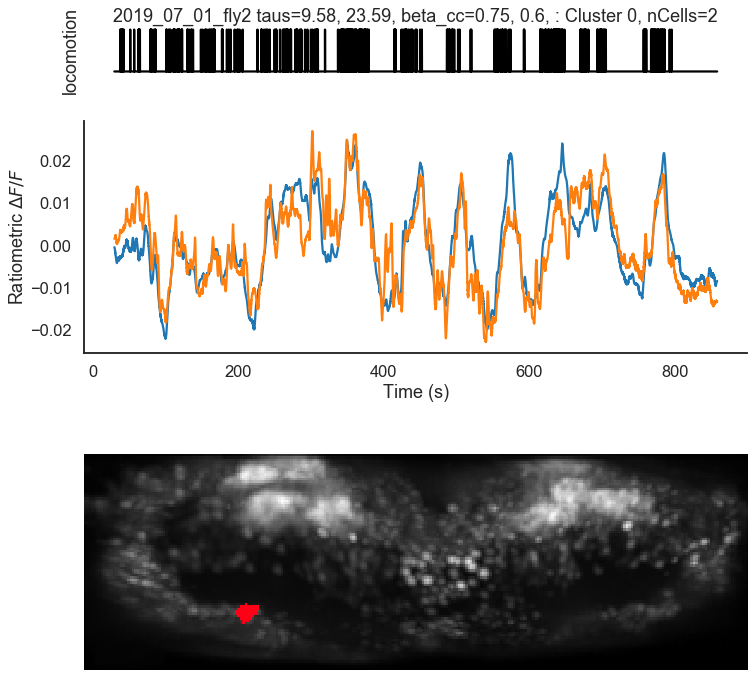

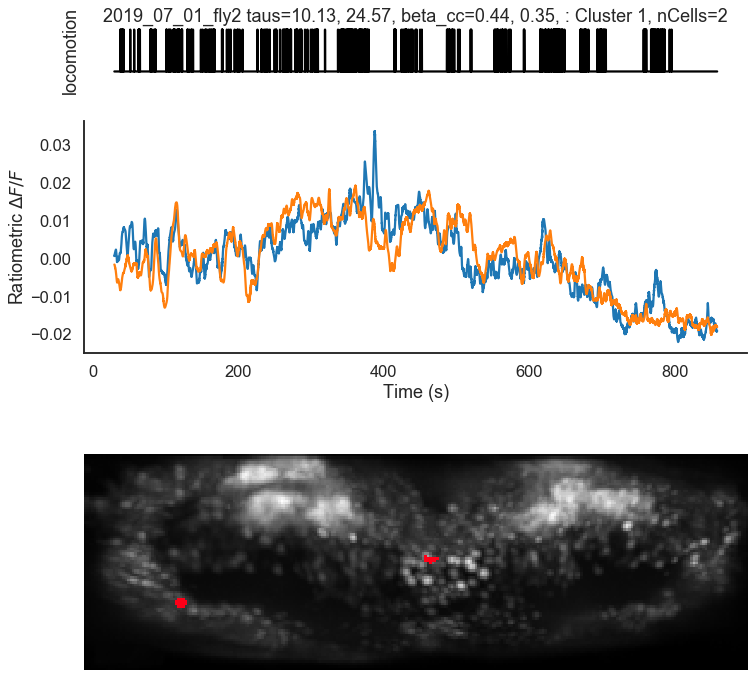

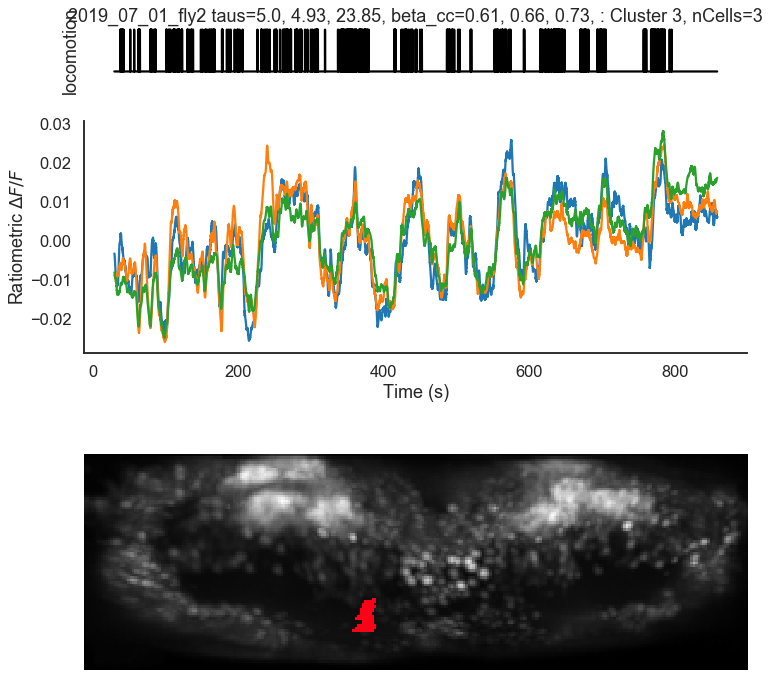

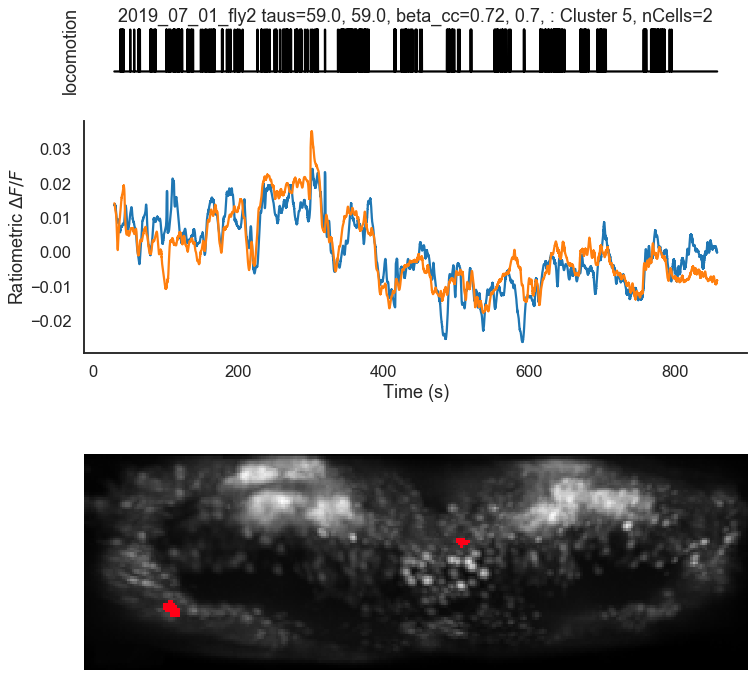

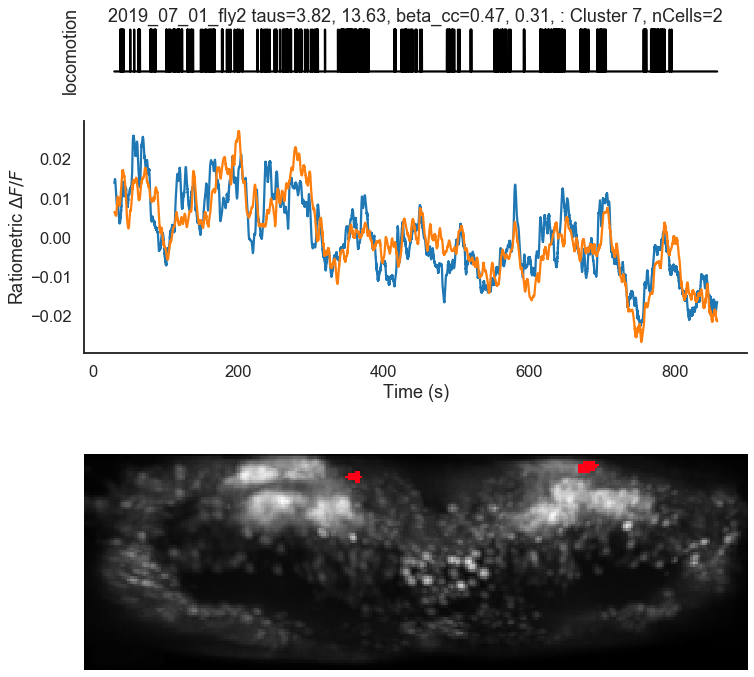

...

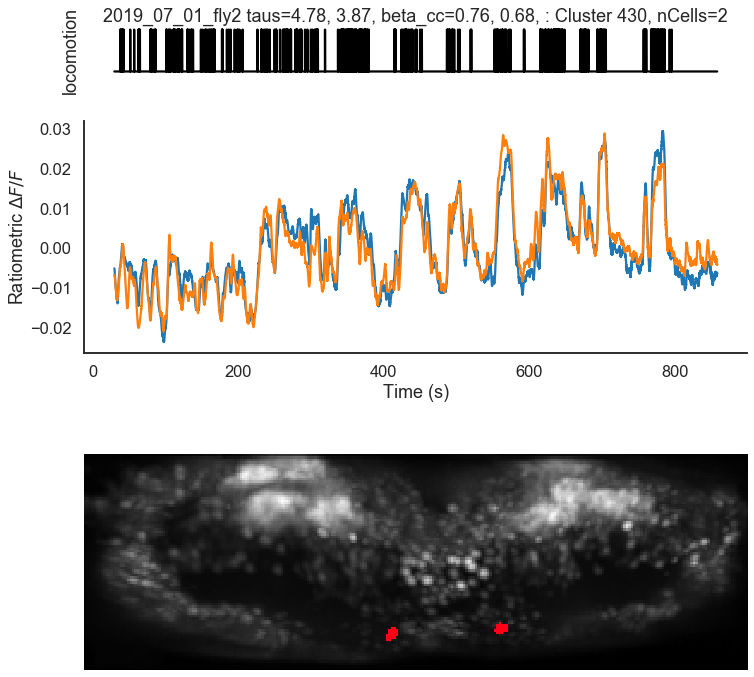

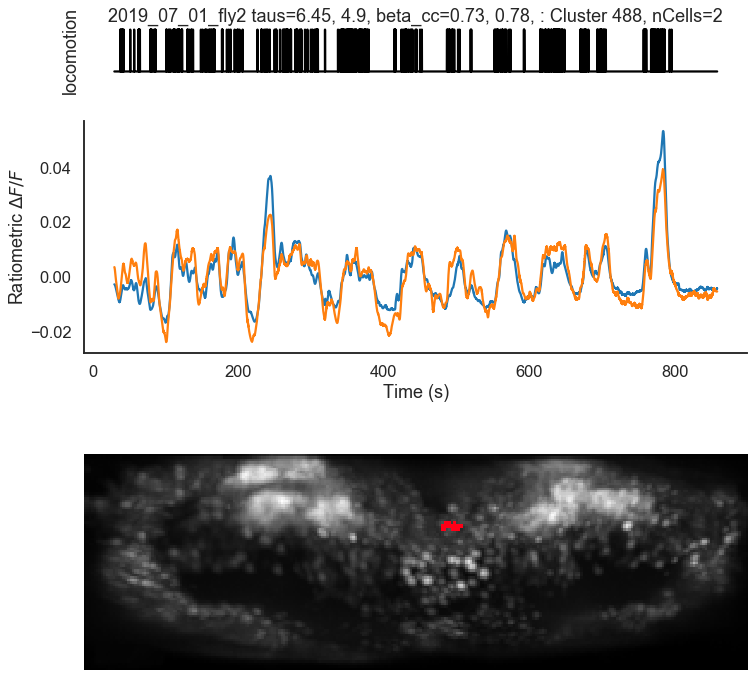

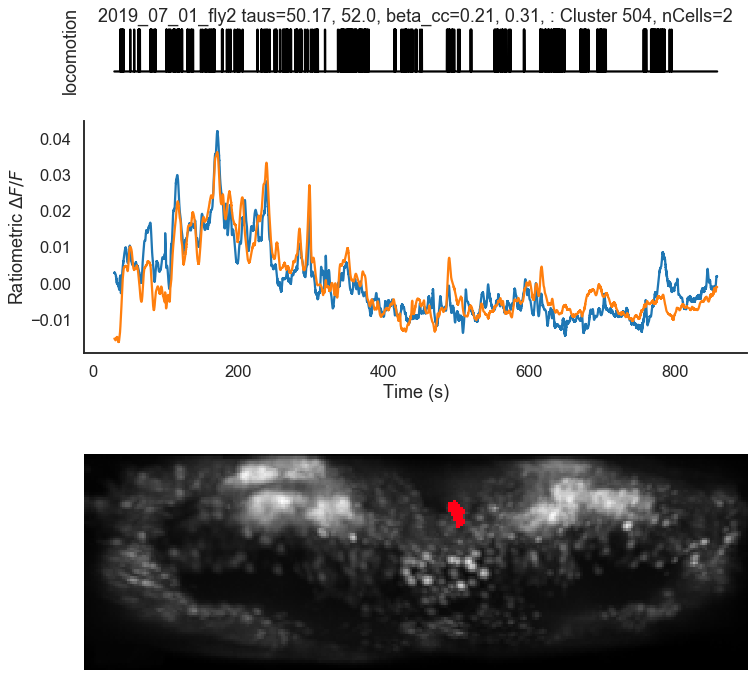

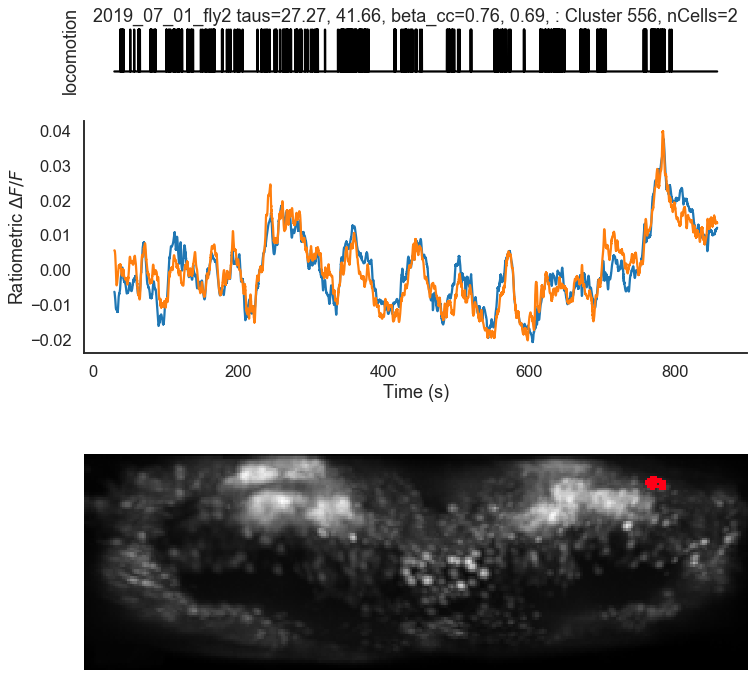

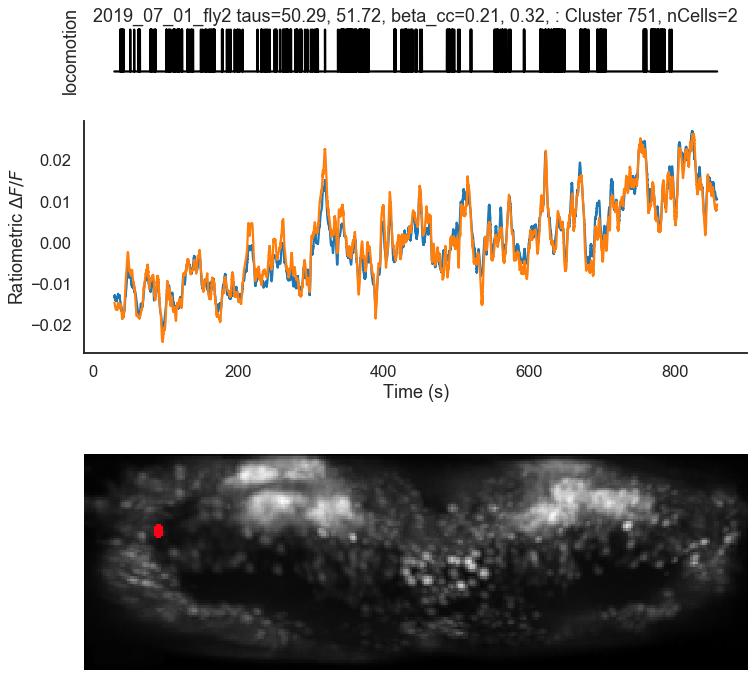

In [478]:
for k in range(clusto.nClust):
    if clusto.clust_is_sig[k]:
        cIds = [i for i,j in enumerate(clusto.cluster.labels_) if j==k]
        tau=''
        bcc=''
        for i in cIds:
            tau += str(round(f['tau'][i],2))+', '
            bcc += str(round(cc['beta_0'][i],2))+', '
        ttl = expt_id+' taus='+tau+'beta_cc='+bcc
        plotting.make_clust_fig(k, cIds, data_dict, expt_id=ttl)
        plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_'+str(k)+'.pdf',transparent=True, bbox_inches='tight')
        plt.show()

In [ ]:
# basic_cols=['#95d0fc', (.2,.2,.2), '#ff474c'] #   #03012d, #363737
# my_cmap=LinearSegmentedColormap.from_list('mycmap', basic_cols)
reload(plotting)
for k in range(clusto.nClust):
    if clusto.clust_is_sig[k]:
        c = np.zeros(len(clusto.cluster.labels_))
        cIds = [i for i,j in enumerate(clusto.cluster.labels_) if j==k]  
        c[cIds] = 1
        plotting.show_colorCoded_cellMap_points(data_dict, c, c, cmap=plotting.cold_to_hot_cmap(), pval=0.01, sort_by='val', color_lims_scale=[-1,1])
        #plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clustMap_'+str(k)+'.pdf', bbox_inches='tight')
        plt.show()


## test symmetry of valid clusters

In [56]:
# plt.scatter(data_dict['aligned_centroids'][:,0],
#                     data_dict['aligned_centroids'][:,1], s=5)
# plt.plot([190,190],[0,200],'y')


In [ ]:
#### show example of GMM image
# k=337
# cIds = [i for i,j in enumerate(clusto.cluster.labels_) if j==k]  
# clusto.mvn_obj.get_img(idx=cIds)
# plt.figure(figsize=(4,4))
# plt.imshow(clusto.mvn_obj.grid_image.max(axis=2).T)
# plt.plot([clusto.mvn_obj.grid_points/2,clusto.mvn_obj.grid_points/2],[0,clusto.mvn_obj.grid_points],'y')
# plt.ylim([clusto.mvn_obj.grid_points-1,0])

# plt.axis('off')
# #plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_symm_cartoon.pdf',transparent=True, bbox_inches='tight')
# plt.show()


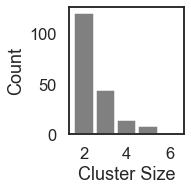

In [57]:
n_sig_clust_by_size = np.zeros(7)
for i in range(2,7):
    n_sig_clust_by_size[i] = clusto.clust_is_sig[clusto.n_clust_members[i]].sum()
    
plt.figure(figsize=(3,3))
plt.bar([i for i in range(2,7)], n_sig_clust_by_size[2:],color='gray',width=0.9)

plt.ylabel('Count')
plt.xlabel('Cluster Size')
plt.xticks([2,4,6])
plt.tight_layout()
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_sig_clust_count.pdf',transparent=True, bbox_inches='tight')
plt.show()

#### Show summary histograms comparing true and shuffled clusters

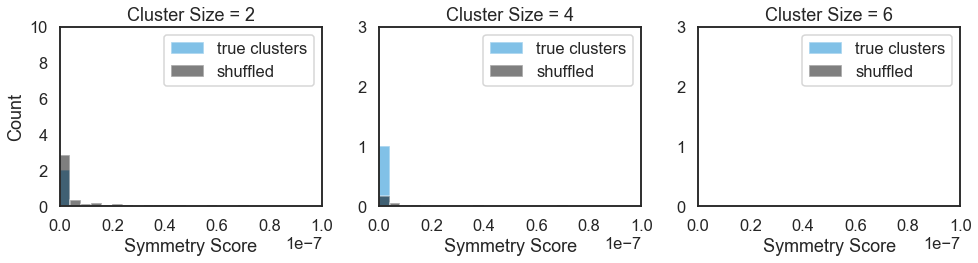

In [58]:
on_both_sides_and_is_sig = np.logical_and(clusto.clust_on_both_sides,clusto.clust_is_sig)

plt.figure(figsize=(14,4))
size_list = [2,4,6]
for i in range(len(size_list)):
    to_plot = []
    right_size_clust = clusto.n_clust_members[size_list[i]]
    for j in range(clusto.nClust):
        if on_both_sides_and_is_sig[j]:
            if j in right_size_clust:
                to_plot.append(j)

    plt.subplot(1,len(size_list),i+1)
    #clusts_to_plot_tmp = clust_symmetry[n_clust_members[size_list[i]]]
    #both_sides_tmp = clust_on_both_sides[n_clust_members[size_list[i]]].astype(bool)
    #clusts_to_plot = clusts_to_plot_tmp[both_sides_tmp]
    clusts_to_plot = clusto.clust_symmetry[to_plot]
    plt.hist(clusts_to_plot,25,(0,1e-7),color='#0485d1',alpha=.5,label='true clusters')
    
    null_weights = np.ones_like(clusto.null_symmetry[size_list[i]]) * len(clusts_to_plot)/len(clusto.null_symmetry[size_list[i]])
    plt.hist(clusto.null_symmetry[size_list[i]],25,(0,1e-7),weights=null_weights,color='k',alpha=.5,label='shuffled')
    

    plt.xlabel('Symmetry Score')
    plt.xlim(0,1e-7)
    if i==0:
        plt.ylabel('Count')
        plt.ylim(0,10)
    else:
        plt.ylim(0,3)
        plt.yticks([0,1,2,3])
    plt.legend()
    plt.title('Cluster Size = '+str(size_list[i]))
plt.tight_layout()
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_symm_hist.pdf',transparent=True, bbox_inches='tight')
plt.show()

In [273]:
to_plot

[]

In [289]:
# plt.figure(figsize=(14,4)) 
# size_list = [2,3,5]
# for i in range(len(size_list)):
#     to_plot = []
#     right_size_clust = clusto.n_clust_members[size_list[i]] 
#     for j in range(clusto.nClust):
#         if clusto.clust_is_sig[j]:
#             if j in right_size_clust:
#                 to_plot.append(j) 
    
#     plt.subplot(1,len(size_list),i+1)
#     clusts_to_plot = clusto.clust_dist_score[to_plot]
#     ulm = 1.05*clusts_to_plot.max() 
#     plt.hist(clusts_to_plot,25,(0,ulm),color='#0485d1',alpha=.6,label='true clusters')

#     null_weights = np.ones_like(clusto.null_dist_score[size_list[i]]) * len(clusts_to_plot)/len(clusto.null_dist_score[size_list[i]])
#     plt.hist(clusto.null_dist_score[size_list[i]],25,(0,ulm),weights=null_weights,color='g',alpha=.5,label='shuffled')

#     null_weights_beh = np.ones_like(clusto.null_dist_score_beh[size_list[i]]) * len(clusts_to_plot)/len(clusto.null_dist_score_beh[size_list[i]])
#     plt.hist(clusto.null_dist_score_beh[size_list[i]],25,(0,ulm),weights=null_weights_beh,color='k',alpha=.5,label='beh. matched shuffled')

#     plt.xlabel('Spatial Order Score') 
#     plt.xlim(0,ulm)
#     if i==0:
#         plt.ylabel('Count')
#         plt.ylim(0,50) 
#     elif i==1:
#         plt.ylim(0,10)
#         plt.yticks([0,5,10])
#     else:
#         plt.ylim(0,5)
#         plt.yticks([0,2.5,5]) 
#     plt.legend()
#     plt.title('Cluster Size = '+str(size_list[i]))

# plt.tight_layout() 
# # plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_dist_score_hist.pdf',transparent=True, bbox_inches='tight')
# plt.show()

### look at examples again

In [65]:
i=0
to_plot = []
right_size_clust = clusto.n_clust_members[size_list[i]]
for j in range(clusto.nClust):
    #if clusto.on_both_sides_and_is_sig[j]:
    if clusto.clust_on_both_sides[j]:
        if j in right_size_clust:
            to_plot.append(j)

clusts_to_plot = clusto.clust_symmetry[to_plot]
clust_plot_order = np.argsort(clusts_to_plot)
print(np.array(to_plot)[clust_plot_order])

[ 29   8  13  54  89  49   5  84   7 430 227  22 130  64  28]


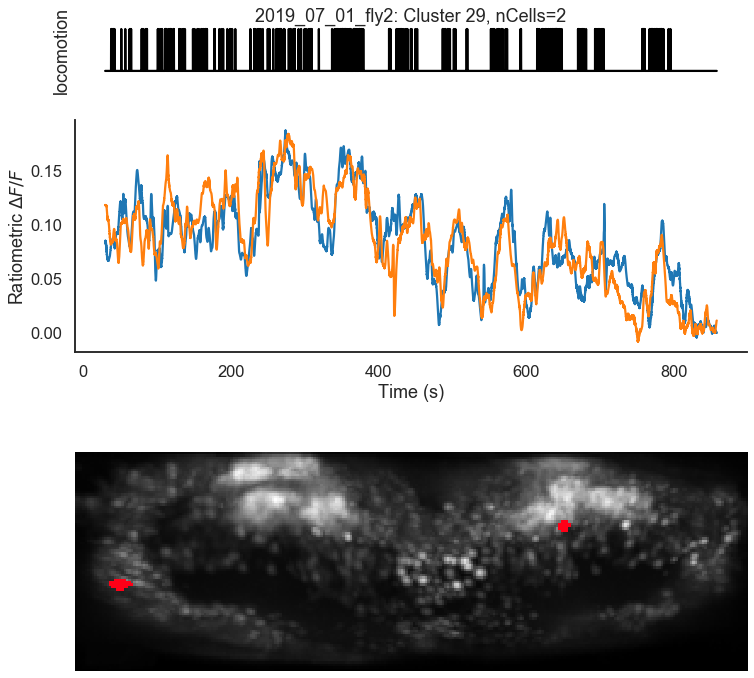

In [84]:
ex_raw_idx=29 #63 #47 #83
data_dict_unnorm = copy.deepcopy(data_dict)
data_dict_unnorm['dFF'] = data_dict_unnorm['dFF_unnormalized']
cIds = [i for i,j in enumerate(clusto.cluster.labels_) if j==ex_raw_idx]
plotting.make_clust_fig(ex_raw_idx, cIds, data_dict_unnorm, expt_id=expt_id, nToPlot=10, include_feeding=False)
#plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_clust_'+str(k)+'.pdf',transparent=True, bbox_inches='tight')
plt.show()



# simple XCorr of neuron pairs

In [154]:
# reload(flclust)
# clusto = flclust.flyg_clust_obj(data_dict)
# clusto.get_simple_clusters()

N clusters (simple): 196


# visualizing large clusters

#### same as above, but now with raw modes 6 & 7

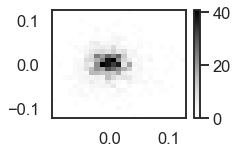

In [81]:
# same, but now project onto all *raw* components to look at proj 6 & 7
lr_model = pickle.load( open(fig_dirs['pkl_dir']+"2019_07_01_fly2_40PCreg_model.pkl","rb") )

# plt.figure(figsize=(6,5))
# plt.scatter(lr_model['U'][:, 6], lr_model['U'][:, 7],s=30,alpha=.25,c='k',cmap='Dark2',vmin=0, vmax=5) #, c=color)
# plt.ylim(-.12,.11)
# plt.xlim(-.11,.14)
# plt.xlabel('Mode 6')
# plt.ylabel('Mode 7')
# plt.tight_layout()
# # plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_6_7_vs_clusters.pdf',transparent=True, bbox_inches='tight')

plt.figure(figsize=(3,2))
h67, xedges67, yedges67, image67 = plt.hist2d(lr_model['U'][:, 6], lr_model['U'][:, 7], bins=25, cmap='Greys')
plt.colorbar()
plt.show()

In [82]:
# choosing clusters to plot differently here than in mode 1v2 example.
# Here, showing only the clusters with at least one member on the dist periphery (usually its partner is also)

mode_67_outlier_cell_idx = (lr_model['U'][:, 6]>0.1) + (abs(lr_model['U'][:, 7])>0.05)
outlier_list = np.flatnonzero(mode_67_outlier_cell_idx)
outlier_clusters = np.unique(agg_clusters[outlier_list]).tolist()
outlier_clusters.remove(-1)
outlier_clusters

tmp = [(i,i) for i in range(len(outlier_clusters))]
agg_clust_outl_colors = [item for sublist in tmp for item in sublist]

# agg_clusters = clusto.agg_clusters
# just_clust_idx = agg_clusters>-1
# u = np.unique(agg_clusters[just_clust_idx])
outlier_clust_cell_ids = np.zeros(2*len(outlier_clusters))
for i in enumerate(outlier_clusters):
    outlier_clust_cell_ids[2*i[0]:2*(i[0]+1)] = np.flatnonzero(agg_clusters==i[1])
    
outlier_clust_cell_ids = outlier_clust_cell_ids.astype(int)

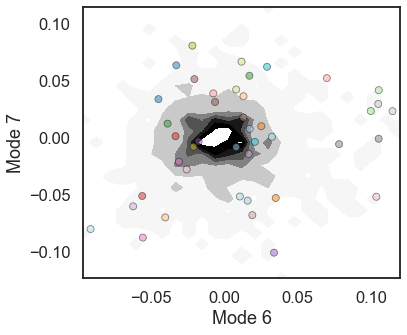

In [83]:
plt.figure(figsize=(6,5))
hplt = h67.T
# hplt[hplt>15]=15
plt.contourf(xedges67[:-1], yedges67[:-1], hplt, levels=[.5,5,15,20,25,30,35], cmap='Greys',vmax=30)

# plt.scatter(lr_model['U'][outlier_clust_cell_ids, 6], lr_model['U'][outlier_clust_cell_ids, 7])
plt.scatter(lr_model['U'][outlier_clust_cell_ids, 6], lr_model['U'][outlier_clust_cell_ids, 7],s=50,alpha=.5,linewidths=0.75,edgecolors='k',
            c=agg_clust_outl_colors, cmap='tab20') #, c=tab20)
# plt.ylim(-.12,.11)
# plt.xlim(-.11,.14)
plt.xlabel('Mode 6')
plt.ylabel('Mode 7')
plt.tight_layout()
# plt.savefig(fig_dirs['clustfig_folder']+expt_id+'_PCs_6_7_vs_agg_clusters.pdf',transparent=True, bbox_inches='tight')


## violin plot

In [ ]:
reload(flclust)
fig, (ax1) = plt.subplots(nrows=1, ncols=1, figsize=(8, 4))

for nf in range(len(exp_list)):
    expt_id = exp_list[nf][0] + '_' + exp_list[nf][1]
    fig_dirs = futils.get_fig_dirs(expt_id)
    data_dict = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_dict.pkl', "rb" ) )
    clusto = pickle.load( open( fig_dirs['pkl_dir'] + expt_id +'_'+'clust_model.pkl', "rb" ) )

    size_list = [2]
    for i in range(len(size_list)):
        to_plot = []
        right_size_clust = clusto.n_clust_members[size_list[i]] 
        for j in range(clusto.nClust):
            if clusto.clust_is_sig[j]:
                if j in right_size_clust:
                    to_plot.append(j) 

        clusts_to_plot = clusto.clust_dist_score[to_plot]
        ulm = 1.05*clusts_to_plot.max() 
        parts = ax1.violinplot(
            clusts_to_plot, positions=[nf], showmeans=False, showmedians=False,
            showextrema=False)
        for pc in parts['bodies']:
            pc.set_facecolor('#0485d1')
            pc.set_edgecolor('black')
            pc.set_alpha(.6)

        null_weights = np.ones_like(clusto.null_dist_score_beh[size_list[i]]) * len(clusts_to_plot)/len(clusto.null_dist_score_beh[size_list[i]])
        parts = ax1.violinplot(
            clusto.null_dist_score_beh[size_list[i]], positions=[nf], showmeans=False, showmedians=False,
            showextrema=False)
        for pc in parts['bodies']:
            pc.set_facecolor('black')
            pc.set_edgecolor('black')
            pc.set_alpha(0.5)


# sandbox - null hypothesis for simple clusters

In [39]:
N = 1000
T = 50000
dFF = np.random.normal(0,1,(N,T))
for n in range(N):
    dFF[n,:] -= dFF[n,:].mean()
    dFF[n,:] /= (dFF[n,:].std()*np.sqrt(T))

In [40]:
aligned_centroids = np.random.rand(N,3)
data_dict = {'dFF':dFF, 'aligned_centroids':aligned_centroids}
clusto = flclust.flyg_clust_obj(data_dict)
clusto.get_simple_clusters(activity='dFF') # corr-based clustering
p_rand = clusto.get_simple_clust_popularity()


N clusters (simple): 251


In [41]:
lp = 2*len(clusto.simple_clust['pairs'])
lp/N

0.502

# reexamining structure in simple clustering

In [33]:
Mlist = np.array([i for i in range(1,100,1)])
f = np.zeros(len(Mlist))

In [34]:
for m in range(len(Mlist)):
    print(m,end=' ')
    M = Mlist[m] # hubs
    N = 500
    T = 10000

    dFF_hub = np.random.normal(0,100,(M,T))

    dFF = np.random.normal(0,1,(N,T))
    for n in range(N):
        dFF[n,:] += dFF_hub[ np.mod(n,M), :]
        dFF[n,:] -= dFF[n,:].mean()
        dFF[n,:] /= (dFF[n,:].std()*np.sqrt(T))
        
    aligned_centroids = np.random.rand(N,3)
    data_dict = {'dFF':dFF, 'aligned_centroids':aligned_centroids}
    clusto = flclust.flyg_clust_obj(data_dict)
    clusto.get_simple_clusters(activity='dFF') # corr-based clustering

    lp = 2*len(clusto.simple_clust['pairs'])
    f[m] = lp/N

0 N clusters (simple): 37
1 N clusters (simple): 35
2 N clusters (simple): 32
3 N clusters (simple): 54
4 N clusters (simple): 48
5 N clusters (simple): 54
6 N clusters (simple): 51
7 N clusters (simple): 45
8 N clusters (simple): 53
9 N clusters (simple): 47
10 N clusters (simple): 52
11 N clusters (simple): 65
12 N clusters (simple): 71
13 N clusters (simple): 64
14 N clusters (simple): 70
15 N clusters (simple): 66
16 N clusters (simple): 65
17 N clusters (simple): 67
18 N clusters (simple): 67
19 N clusters (simple): 74
20 N clusters (simple): 71
21 N clusters (simple): 76
22 N clusters (simple): 65
23 N clusters (simple): 71
24 N clusters (simple): 71
25 N clusters (simple): 71
26 N clusters (simple): 78
27 N clusters (simple): 76
28 N clusters (simple): 80
29 N clusters (simple): 82
30 N clusters (simple): 76
31 N clusters (simple): 86
32 N clusters (simple): 92
33 N clusters (simple): 79
34 N clusters (simple): 81
35 N clusters (simple): 84
36 N clusters (simple): 84
37 N cluste

In [35]:
dirs = futils.get_dirs()


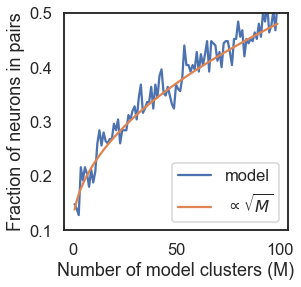

In [42]:
plt.figure(figsize=(4,4))
plt.plot(Mlist,f,label='model')
plt.plot(Mlist, .1+.027*np.sqrt(2*Mlist),label=r'$\propto\sqrt{M}$')
plt.xlabel('Number of model clusters (M)')
plt.ylabel('Fraction of neurons in pairs')
plt.ylim(.1,.5)
plt.legend(loc='lower right')

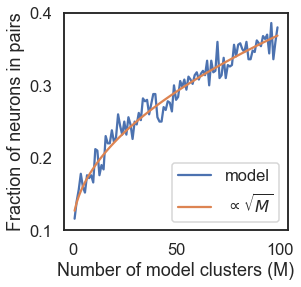

In [428]:
plt.figure(figsize=(4,4))
plt.plot(Mlist,f,label='model')
plt.plot(Mlist, .1+.027*np.sqrt(Mlist),label=r'$\propto\sqrt{M}$')
plt.xlabel('Number of model clusters (M)')
plt.ylabel('Fraction of neurons in pairs')
plt.ylim(.1,.4)
plt.legend(loc='lower right')

plt.savefig( dirs['results']+'_simple_clust_model_fraction_in_clust.pdf',transparent=True, bbox_inches='tight')

# plt.yscale('log')
# plt.xscale('log')

In [433]:
M = 1
N = 1000
T = 5000
sig = 10

# z
dFF_hub = np.random.normal(0,sig,(M,T))
dFF_hub -= dFF_hub.mean()
dFF_hub *= sig/dFF_hub.std()

# x
dFF_tmp = np.random.normal(0,1,(N,T))
sig_x = np.zeros(N)
for n in range(N):
    dFF_tmp[n,:] -= dFF_tmp[n,:].mean()
    sig_x[n] = dFF_tmp[n,:].std()
    #dFF_tmp[n,:] /= dFF_tmp[n,:].std()
dFF = dFF_tmp.copy()

# f
for n in range(N):
    dFF[n,:] += dFF_hub[ np.mod(n,M), :]
    dFF[n,:] /= (dFF[n,:].std()*np.sqrt(T))

aligned_centroids = np.random.rand(N,3)
data_dict = {'dFF':dFF, 'aligned_centroids':aligned_centroids}
clusto = flclust.flyg_clust_obj(data_dict)
clusto.get_simple_clusters(activity='dFF') # corr-based clustering

lp = 2*len(clusto.simple_clust['pairs'])
print(lp/N)

N clusters (simple): 45
0.09


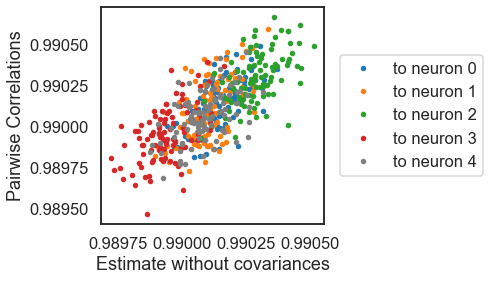

In [434]:
plt.figure(figsize=(4,4))
c = ['tab:blue','tab:orange','tab:green','tab:red','tab:gray']
for i in range(5):
    for j in range(100,200):
        est = sig**2/( sig**2 + sig_x[i]**2/2 + sig_x[j]**2/2 )
        if j==100:
            plt.plot(est ,dFF[i,:]@dFF[j,:],'.',color=c[i], label='to neuron '+str(i))
        else:
            plt.plot(est ,dFF[i,:]@dFF[j,:],'.',color=c[i])
plt.legend(bbox_to_anchor=(1.75, .5), loc='right')
plt.xlabel('Estimate without covariances')
plt.ylabel('Pairwise Correlations')
plt.savefig( dirs['results']+'_simple_clust_model_variance_predicts_popularity.pdf',transparent=True, bbox_inches='tight')


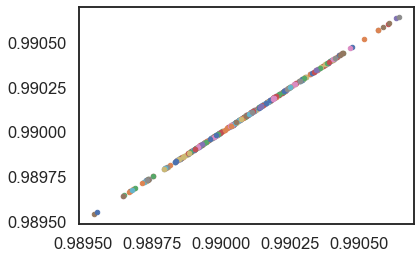

In [393]:
for i in range(20):
    for j in range(21,40):
        #D1 = np.sqrt( sig**2 + sig_x[i]**2 + 2*sig*sig_x[i] )
        #D2 = np.sqrt( sig**2 + sig_x[j]**2 + 2*sig*sig_x[j] )
        D1 = np.sqrt( ((dFF_hub+dFF_tmp[i,:])**2).sum()/T )
        D2 = np.sqrt( ((dFF_hub+dFF_tmp[j,:])**2).sum()/T )
        num = (dFF_hub+dFF_tmp[i,:])@(dFF_hub+dFF_tmp[j,:]).T/T
        #num = sig**2 + (dFF_hub@dFF_tmp[i,:]).T/T + (dFF_hub@dFF_tmp[j,:]).T/T + dFF_tmp[i,:]@dFF_tmp[j,:].T/T
        #num = sig**2 + (dFF_hub@dFF_tmp[i,:]).T/T + (dFF_hub@dFF_tmp[j,:]).T/T #+ dFF_tmp[i,:]@dFF_tmp[j,:].T/T
        est = num/( D1*D2 )
        plt.plot(est ,dFF[i,:]@dFF[j,:],'.')

## hierarchical interpretation of simple clustering

In [82]:
M = 60 # hubs
N = 1000
T = 10000

dFF_hub = np.random.normal(0,100,(M,T))

dFF = np.random.normal(0,1,(N,T))
for n in range(N):
    dFF[n,:] += dFF_hub[ np.mod(n,M), :]
    dFF[n,:] -= dFF[n,:].mean()
    dFF[n,:] /= (dFF[n,:].std()*np.sqrt(T))

In [83]:
aligned_centroids = np.random.rand(N,3)
data_dict = {'dFF':dFF, 'aligned_centroids':aligned_centroids}
clusto = flclust.flyg_clust_obj(data_dict)
clusto.get_simple_clusters(activity='dFF') # corr-based clustering


N clusters (simple): 154


In [84]:
lp = 2*len(clusto.simple_clust['pairs'])
lp/N

0.308

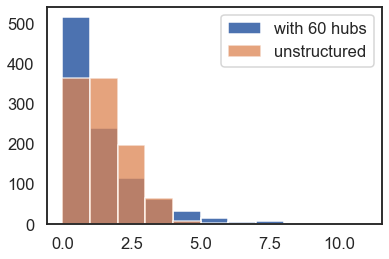

In [49]:
p_hubs = clusto.get_simple_clust_popularity()
bins = np.array([i for i in range(int(p_hubs.max())+1)]) #/N
plt.hist(p_hubs,bins, label='with '+str(M)+' hubs')
plt.hist(p_rand,bins,alpha=.75, label='unstructured')
plt.legend()
plt.show()

# test navigating to parents/children

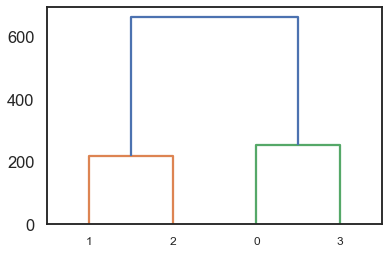

In [27]:
from scipy.cluster import hierarchy
ytdist = np.array([662., 877., 255., 219., 669., 869.])
Z = hierarchy.linkage(ytdist, 'single')
plt.figure()
dn = hierarchy.dendrogram(Z)

In [28]:
ac = AgglomerativeClustering(n_clusters=None, affinity='euclidean', linkage='ward',distance_threshold=100)  
ac.fit_predict(np.expand_dims(ytdist,axis=1))

array([2, 1, 0, 0, 2, 1])

In [29]:
ytdist.astype(int)

array([662, 877, 255, 219, 669, 869])

In [30]:
ac.labels_

array([2, 1, 0, 0, 2, 1])

In [31]:
ac.children_

array([[0, 4],
       [1, 5],
       [2, 3],
       [6, 7],
       [8, 9]])

In [ ]:

# create the counts of samples under each node
counts = np.zeros(model.children_.shape[0])
n_samples = len(model.labels_)
for i, merge in enumerate(model.children_):
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            current_count += 1  # leaf node
        else:
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

